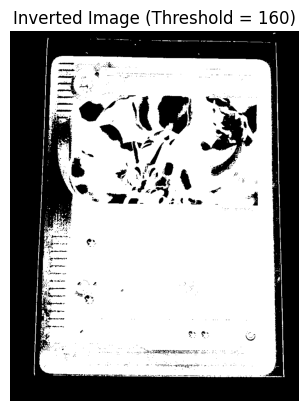

Number of contours found: 258


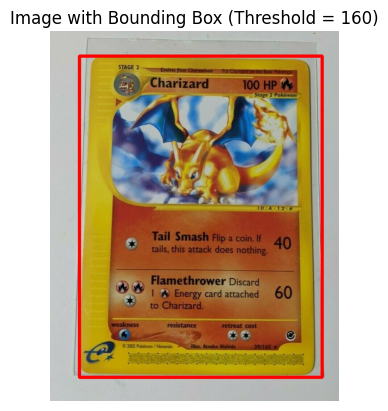

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image using OpenCV
image = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\image-0.jpg')

# Convert the image to RGB (OpenCV loads images in BGR format by default)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Convert the image to grayscale
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

# Apply a threshold to turn non-white pixels to black (adjust threshold as needed)
threshold_value = 160  # You can adjust this value
_, thresholded = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY)

# Invert the binary image so that black object becomes white and background becomes black
inverted = cv2.bitwise_not(thresholded)

# Display the inverted image to confirm inversion worked
plt.imshow(inverted, cmap='gray')
plt.title(f"Inverted Image (Threshold = {threshold_value})")
plt.axis('off')
plt.show()

# Find contours of the black object in the inverted image
contours, _ = cv2.findContours(inverted, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Check if any contours were found
if contours:
    print(f"Number of contours found: {len(contours)}")

    # Find the largest contour (assuming object is the largest)
    largest_contour = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest_contour)
    
    # Draw the bounding box on the original image
    cv2.rectangle(image_rgb, (x, y), (x + w, y + h), (255, 0, 0), 7)  # Red bounding box

    # Display the original image with bounding box
    plt.imshow(image_rgb)
    plt.title(f"Image with Bounding Box (Threshold = {threshold_value})")
    plt.axis('off')
    plt.show()
else:
    print("No contours were found.")


Text in ROI:
6



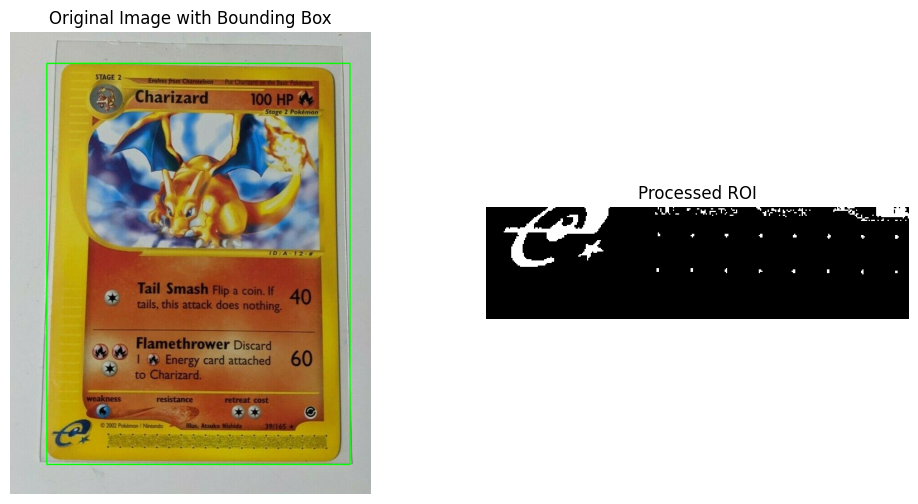

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pytesseract
from PIL import Image

# Path to your Tesseract-OCR executable
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'  # Update this path if necessary

# Convert the image to RGB
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Convert the image to grayscale
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

# Apply a threshold for bounding box detection (keeping black)
bounding_box_threshold_value = 160  # You can adjust this value
_, thresholded = cv2.threshold(gray, bounding_box_threshold_value, 255, cv2.THRESH_BINARY_INV)  # Invert to get black as white

# Find contours
contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

if contours:
    largest_contour = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest_contour)

    # Draw bounding box around the detected object
    image_with_box = image_rgb.copy()
    cv2.rectangle(image_with_box, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Draw green box

    # Define ROI (bottom 1/10 of the bounding box and left 50% of the width)
    roi_height = h // 10
    roi_width = int(w * 0.5)
    roi_y_start = y + h - roi_height

    # Extract the ROI from the original image
    roi = image_rgb[roi_y_start:roi_y_start + roi_height, x:x + roi_width]

    # Convert ROI to grayscale
    roi_gray = cv2.cvtColor(roi, cv2.COLOR_RGB2GRAY)

    # Apply threshold to convert non-black colors to white
    roi_threshold_value = 80  # Adjust this value as needed
    _, roi_bw = cv2.threshold(roi_gray, roi_threshold_value, 255, cv2.THRESH_BINARY_INV)  # Non-black to white

    # Convert ROI to a PIL image for OCR
    roi_pil = Image.fromarray(roi_bw)

    # Perform OCR on the ROI with character whitelisting
    custom_config = r'--psm 11 -c tessedit_char_whitelist=0123456789/SMWHXYDPBG'
    text_roi = pytesseract.image_to_string(roi_pil, config=custom_config)

    # Print extracted text from ROI
    print("Text in ROI:")
    print(text_roi)

    # Plot the original image with bounding box and the processed ROI
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(image_with_box)
    plt.title("Original Image with Bounding Box")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(roi_bw, cmap='gray')
    plt.title("Processed ROI")
    plt.axis('off')

    plt.show()
else:
    print("No contours were found.")


In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pytesseract
from PIL import Image
import re

# Path to your Tesseract-OCR executable
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'  # Update this path if necessary


# Convert the image to RGB
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Convert the image to grayscale
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

# Apply a threshold for bounding box detection (keeping black)
bounding_box_threshold_value = 160  # You can adjust this value
_, thresholded = cv2.threshold(gray, bounding_box_threshold_value, 255, cv2.THRESH_BINARY_INV)  # Invert to get black as white

# Find contours
contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

if contours:
    largest_contour = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest_contour)

    # Define ROI (bottom 1/10 of the bounding box and left 50% of the width)
    roi_height = h // 10
    roi_width = int(w * 0.5)
    roi_y_start = y + h - roi_height

    # Extract the ROI from the original image
    roi = image_rgb[roi_y_start:roi_y_start + roi_height, x:x + roi_width]

    # Convert ROI to grayscale
    roi_gray = cv2.cvtColor(roi, cv2.COLOR_RGB2GRAY)

    # Apply threshold to convert non-black colors to white
    roi_threshold_value = 80  # Adjust this value as needed
    _, roi_bw = cv2.threshold(roi_gray, roi_threshold_value, 255, cv2.THRESH_BINARY_INV)  # Non-black to white

    # Convert ROI to a PIL image for OCR
    roi_pil = Image.fromarray(roi_bw)

    # Perform OCR on the ROI
    custom_config = r'--psm 11 -c tessedit_char_whitelist=0123456789/'
    text_roi = pytesseract.image_to_string(roi_pil, config=custom_config)

    # Define regex patterns for matching desired text
    pattern1 = r'\b\d{1,3}/\d{1,3}\b'  # Matches format like 0/123
    pattern2 = r'\b[a-zA-Z]{2,4}\s*\d{1,3}\b'  # Matches format like XX123

    # Search for matches in text_roi
    matches = re.findall(pattern1, text_roi) + re.findall(pattern2, text_roi)

    # Print extracted matches
    print("Extracted Sections:")
    for match in matches:
        print(match)
else:
    print("No contours were found.")


Extracted Sections:


In [10]:
image = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\IMG_1535_1024x1024.webp')

In [6]:
import tensorflow as tf
from tensorflow import keras
import keras
from tensorflow.keras import layers, models, regularizers
from tensorflow.keras.layers import InputLayer, RandomFlip, RandomRotation, RandomZoom, Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.models import load_model, Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from scipy.ndimage import rotate, geometric_transform
from tensorflow.image import resize_with_crop_or_pad
from tensorflow.keras.optimizers import Adam

In [7]:
from keras.models import load_model
from keras import activations
model = load_model(r'C:\Users\Jimmy\Desktop\final-project\PokemonTCG\models\model03.keras')

model.summary()



Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 148, 148, 16)   │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 148, 148, 16)   │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 74, 74, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 72, 72, 32)     │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 72, 72, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 36, 36, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 34, 34, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 34, 34, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 17, 17, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 15, 15, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 15, 15, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 7, 7, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 6272)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │     3,211,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 147)            │        75,411 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 10,159,899 (38.76 MB)

 Trainable params: 3,386,131 (12.92 MB)

 Non-trainable params: 1,504 (5.88 KB)

 Optimizer params: 6,772,264 (25.83 MB)

In [11]:
import cv2
import numpy as np
import pytesseract
from PIL import Image
import re

# Path to your Tesseract-OCR executable
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'  # Update this path if necessary

# Function to calculate variance (uniformity)
def calculate_uniformity(roi):
    # Convert ROI to grayscale
    roi_gray = cv2.cvtColor(roi, cv2.COLOR_RGB2GRAY)
    # Calculate the variance of pixel intensities
    variance = np.var(roi_gray)
    return variance

# Convert the image to RGB
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Convert the image to grayscale
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

# Apply a threshold for bounding box detection (keeping black)
bounding_box_threshold_value = 160  # You can adjust this value
_, thresholded = cv2.threshold(gray, bounding_box_threshold_value, 255, cv2.THRESH_BINARY_INV)  # Invert to get black as white

# Find contours
contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

if contours:
    largest_contour = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest_contour)

    # --- Text ROI (for OCR) ---
    # Define text ROI (bottom 1/10 of the bounding box and left 50% of the width)
    text_roi_height = h // 10
    text_roi_width = int(w * 0.5)
    text_roi_y_start = y + h - text_roi_height

    # Extract the text ROI from the original image
    text_roi = image_rgb[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

    # Convert text ROI to grayscale
    text_roi_gray = cv2.cvtColor(text_roi, cv2.COLOR_RGB2GRAY)

    # Apply threshold to convert non-black colors to white
    text_roi_threshold_value = 80  # Adjust this value as needed
    _, text_roi_bw = cv2.threshold(text_roi_gray, text_roi_threshold_value, 255, cv2.THRESH_BINARY_INV)  # Non-black to white

    # Convert text ROI to a PIL image for OCR
    text_roi_pil = Image.fromarray(text_roi_bw)

    # Perform OCR on the text ROI
    custom_config = r'--psm 11 -c tessedit_char_whitelist=0123456789/'
    text_roi_result = pytesseract.image_to_string(text_roi_pil, config=custom_config)

    # Define regex patterns for matching desired text
    pattern1 = r'\b\d{1,3}/\d{1,3}\b'  # Matches format like 0/123
    pattern2 = r'\b[a-zA-Z]{2,4}\s*\d{1,3}\b'  # Matches format like XX123

    # Search for matches in text_roi_result
    matches = re.findall(pattern1, text_roi_result) + re.findall(pattern2, text_roi_result)

    # Print extracted matches
    print("Extracted Sections:")
    for match in matches:
        print(match)

    # --- Set Symbol ROIs ---
    # Define the set symbol ROIs (bottom left, bottom right, and middle of the card)
    
    # Bottom left ROI
    roi_bottom_left = image_rgb[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width // 2]
    
    # Bottom right ROI
    roi_bottom_right = image_rgb[text_roi_y_start:text_roi_y_start + text_roi_height, x + text_roi_width // 2:x + text_roi_width]
    
    # Middle ROI (centered in the card, same size)
    roi_middle = image_rgb[text_roi_y_start - text_roi_height // 2:text_roi_y_start + text_roi_height // 2, x + text_roi_width // 4:x + 3 * text_roi_width // 4]

    # Calculate variance (uniformity) for each ROI
    variance_bottom_left = calculate_uniformity(roi_bottom_left)
    variance_bottom_right = calculate_uniformity(roi_bottom_right)
    variance_middle = calculate_uniformity(roi_middle)

    # Determine the ROI with the highest variance
    variances = {
        'bottom_left': variance_bottom_left,
        'bottom_right': variance_bottom_right,
        'middle': variance_middle
    }

    max_roi_name = max(variances, key=variances.get)
    print(f"ROI with the highest variance: {max_roi_name}, Variance: {variances[max_roi_name]}")

    # Select the ROI with the highest variance
    if max_roi_name == 'bottom_left':
        selected_roi = roi_bottom_left
    elif max_roi_name == 'bottom_right':
        selected_roi = roi_bottom_right
    else:
        selected_roi = roi_middle

    # Here you can apply the CNN model to `selected_roi`
    # Example placeholder:
    # prediction = model.predict(selected_roi)

else:
    print("No contours were found.")


Extracted Sections:
186/167
ROI with the highest variance: bottom_right, Variance: 4013.5027816578736


Variance (Bottom Left ROI): 3997.6902691782993
Variance (Bottom Right ROI): 4579.024271949089
Variance (Middle ROI): 4705.390608792706


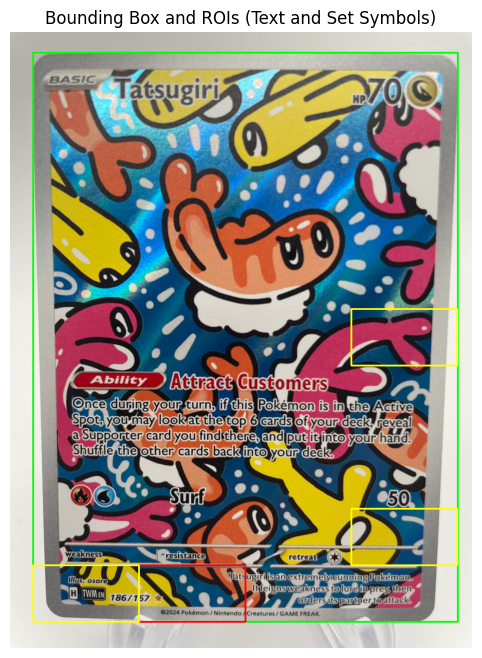

In [12]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Function to calculate variance (uniformity) of an ROI
def calculate_variance(roi):
    # Convert to grayscale
    roi_gray = cv2.cvtColor(roi, cv2.COLOR_RGB2GRAY)
    # Calculate variance of pixel intensities
    variance = np.var(roi_gray)
    return variance

# Convert the image to RGB
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Convert the image to grayscale
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

# Apply a threshold for bounding box detection (keeping black)
bounding_box_threshold_value = 160  # You can adjust this value
_, thresholded = cv2.threshold(gray, bounding_box_threshold_value, 255, cv2.THRESH_BINARY_INV)  # Invert to get black as white

# Find contours
contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

if contours:
    largest_contour = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest_contour)

    # --- Text ROI (for OCR) ---
    # Define text ROI (bottom 1/10 of the bounding box and left 50% of the width)
    text_roi_height = h // 10
    text_roi_width = int(w * 0.5)
    text_roi_y_start = y + h - text_roi_height

    # Define the text ROI coordinates (for visualization)
    text_roi_coords = (x, text_roi_y_start, text_roi_width, text_roi_height)

    # --- Set Symbol ROIs ---
    # Bottom left ROI (left half of the bottom 1/10th of the bounding box)
    roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)

    # Bottom right ROI (right half of the bottom 1/10th of the bounding box, stacked above)
    roi_bottom_right_coords = (x + w // 2 + w // 4, y + h - 2 * text_roi_height, w // 4, text_roi_height)

    # Middle ROI (centered vertically in the bounding box, right half)
    roi_middle_coords = (x + w // 2 + w // 4, y + h // 2 - text_roi_height // 2, w // 4, text_roi_height)

    # Extract the ROIs from the image
    roi_bottom_left = image_rgb[roi_bottom_left_coords[1]:roi_bottom_left_coords[1] + roi_bottom_left_coords[3],
                                roi_bottom_left_coords[0]:roi_bottom_left_coords[0] + roi_bottom_left_coords[2]]

    roi_bottom_right = image_rgb[roi_bottom_right_coords[1]:roi_bottom_right_coords[1] + roi_bottom_right_coords[3],
                                 roi_bottom_right_coords[0]:roi_bottom_right_coords[0] + roi_bottom_right_coords[2]]

    roi_middle = image_rgb[roi_middle_coords[1]:roi_middle_coords[1] + roi_middle_coords[3],
                           roi_middle_coords[0]:roi_middle_coords[0] + roi_middle_coords[2]]

    # Calculate variance for each ROI
    variance_bottom_left = calculate_variance(roi_bottom_left)
    variance_bottom_right = calculate_variance(roi_bottom_right)
    variance_middle = calculate_variance(roi_middle)

    # Print the variances
    print(f"Variance (Bottom Left ROI): {variance_bottom_left}")
    print(f"Variance (Bottom Right ROI): {variance_bottom_right}")
    print(f"Variance (Middle ROI): {variance_middle}")

    # Draw bounding box and ROIs
    image_with_rois = image_rgb.copy()

    # Draw the bounding box (around the entire detected region)
    cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Draw the text ROI (different color for clarity)
    cv2.rectangle(image_with_rois, (text_roi_coords[0], text_roi_coords[1]), 
                  (text_roi_coords[0] + text_roi_coords[2], text_roi_coords[1] + text_roi_coords[3]), 
                  (255, 0, 0), 2)  # Blue for text ROI

    # Draw the three set symbol ROIs (same color)
    cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]), 
                  (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]), 
                  (255, 255, 0), 2)  # Yellow for set symbol ROI

    cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]), 
                  (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]), 
                  (255, 255, 0), 2)  # Yellow for set symbol ROI

    cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]), 
                  (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]), 
                  (255, 255, 0), 2)  # Yellow for set symbol ROI

    # Display the image with the ROIs using Matplotlib
    plt.figure(figsize=(10, 8))
    plt.imshow(image_with_rois)
    plt.title("Bounding Box and ROIs (Text and Set Symbols)")
    plt.axis("off")
    plt.show()

else:
    print("No contours were found.")


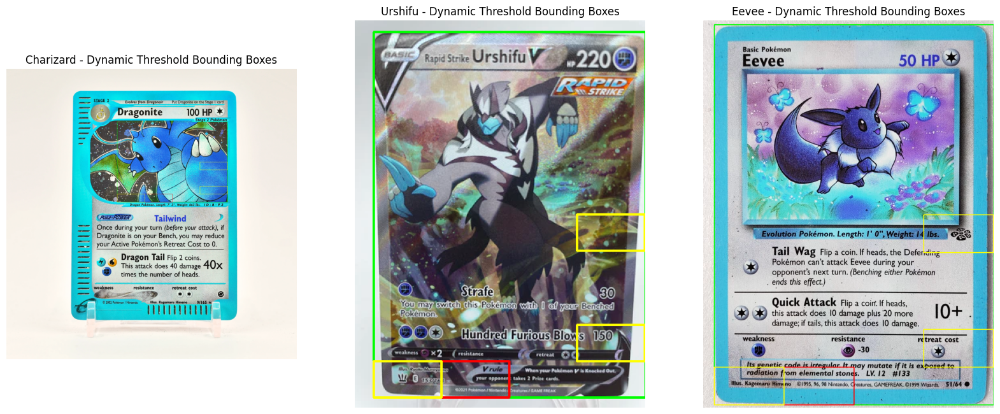

In [13]:
image1_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\e-reader.webp')
image2_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\IMG_1537_360x.webp')
eevee_image_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\s-l1200.jpg')

# Function to dynamically adjust the threshold based on the card's brightness level
def draw_roi_boxes_with_dynamic_threshold(image_rgb):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)

    # Calculate the mean brightness of the card
    mean_brightness = np.mean(gray)

    # Set the threshold based on the brightness
    if mean_brightness > 180:
        # If the card is very bright (like Eevee), use a lower threshold value for better detection
        bounding_box_threshold_value = 80
    else:
        # Use a higher threshold value for darker cards (like Charizard or Urshifu)
        bounding_box_threshold_value = 160

    # Apply the dynamically chosen threshold
    _, thresholded = cv2.threshold(gray, bounding_box_threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Find contours
    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height

        # --- Set Symbol ROIs ---
        roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)
        roi_bottom_right_coords = (x + w // 2 + w // 4, y + h - 2 * text_roi_height, w // 4, text_roi_height)
        roi_middle_coords = (x + w // 2 + w // 4, y + h // 2, w // 4, text_roi_height)

        # Draw bounding box and ROIs
        image_with_rois = image_rgb.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Draw the text ROI (blue)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start), 
                      (x + text_roi_width, text_roi_y_start + text_roi_height), 
                      (255, 0, 0), 2)  # Blue for text ROI

        # Draw the three set symbol ROIs (yellow)
        cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]), 
                      (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]), 
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]), 
                      (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]), 
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]), 
                      (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]), 
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        return image_with_rois
    else:
        print("No contours were found.")
        return image_rgb

# Apply the dynamic threshold function to all three images (Charizard, Urshifu, Eevee)
charizard_dynamic_output = draw_roi_boxes_with_dynamic_threshold(image1_rgb)
urshifu_dynamic_output = draw_roi_boxes_with_dynamic_threshold(image2_rgb)
eevee_dynamic_output = draw_roi_boxes_with_dynamic_threshold(eevee_image_rgb)

# Display the results for all three cards with dynamic thresholding
plt.figure(figsize=(20, 15))

# Charizard
plt.subplot(1, 3, 1)
plt.imshow(charizard_dynamic_output)
plt.title("Charizard - Dynamic Threshold Bounding Boxes")
plt.axis("off")

# Urshifu
plt.subplot(1, 3, 2)
plt.imshow(urshifu_dynamic_output)
plt.title("Urshifu - Dynamic Threshold Bounding Boxes")
plt.axis("off")

# Eevee
plt.subplot(1, 3, 3)
plt.imshow(eevee_dynamic_output)
plt.title("Eevee - Dynamic Threshold Bounding Boxes")
plt.axis("off")

plt.show()


Matches from First Text ROI: 
Matches from Second Text ROI: 
Matches from First Text ROI: 
Matches from Second Text ROI: 
Matches from First Text ROI: 19959698

Matches from Second Text ROI: 1124133

1999

51/64

Matches from First Text ROI: 6 2002 /

Matches from Second Text ROI: 965



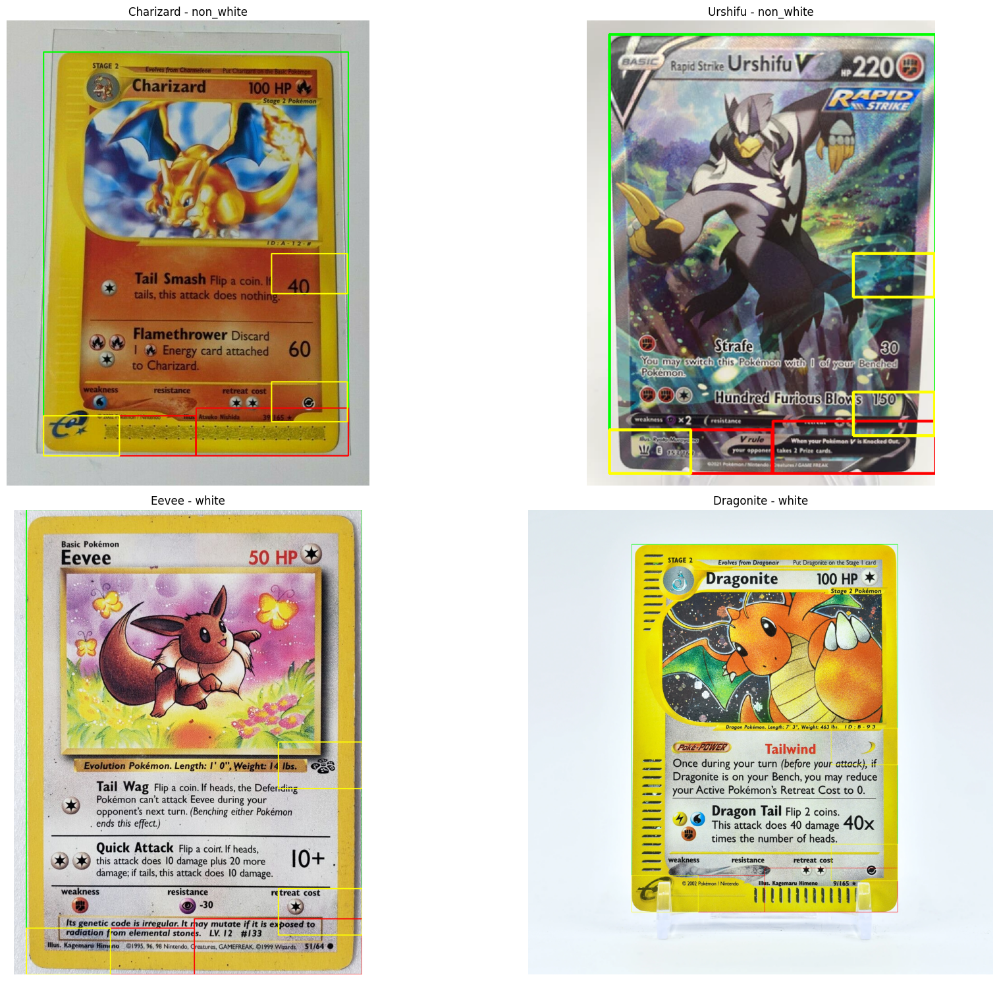

In [14]:
# Function to classify a card as white or non-white
def classify_card(image_rgb):
    """
    Classify a card as white or non-white based on its brightness level.
    """
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    mean_brightness = np.mean(gray)
    
    # Consider a card white if the mean brightness is greater than 200
    if mean_brightness > 150:
        return "white"
    else:
        return "non_white"

# Function to perform OCR on ROIs
def perform_ocr_on_roi(image_roi):
    # Convert the ROI to grayscale and apply threshold
    roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
    _, roi_bw = cv2.threshold(roi_gray, 80, 255, cv2.THRESH_BINARY_INV)

    # Convert ROI to a PIL image for OCR
    roi_pil = Image.fromarray(roi_bw)

    # Perform OCR on the ROI
    custom_config = r'--psm 11 -c tessedit_char_whitelist=0123456789/'
    text_roi = pytesseract.image_to_string(roi_pil, config=custom_config)

    # Return the raw OCR text
    return text_roi


# # Function to perform OCR on ROIs
# def perform_ocr_on_roi(image_roi):
#     # Convert the ROI to grayscale and apply threshold
#     roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
#     _, roi_bw = cv2.threshold(roi_gray, 80, 255, cv2.THRESH_BINARY_INV)

#     # Convert ROI to a PIL image for OCR
#     roi_pil = Image.fromarray(roi_bw)

#     # Perform OCR on the ROI
#     custom_config = r'--psm 11 -c tessedit_char_whitelist=0123456789/'
#     text_roi = pytesseract.image_to_string(roi_pil, config=custom_config)

#     # Define regex patterns for matching desired text
#     pattern1 = r'\b\d{1,3}/\d{1,3}\b'  # Matches format like 0/123
#     pattern2 = r'\b[a-zA-Z]{2,4}\s*\d{1,3}\b'  # Matches format like XX123

#     # Search for matches in text_roi
#     matches = re.findall(pattern1, text_roi) + re.findall(pattern2, text_roi)

#     return matches

# Updated function to apply the white card bounding method with ROIs
def draw_bounding_box_full_card_with_rois(image_bgr):
    """
    Ensure the entire card is captured, ROIs are drawn, and OCR is applied for white-background cards.
    """
    # Convert the image to grayscale
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

    # Apply a threshold for white backgrounds
    _, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY_INV)

    # Find contours in the thresholded image
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        # Find the largest contour for the bounding box
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height

        # Extract the first text ROI from the image
        first_text_roi = image_bgr[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Apply OCR on the first text ROI
        matches_first_text_roi = perform_ocr_on_roi(first_text_roi)
        print("Matches from First Text ROI:", matches_first_text_roi)

        # --- Second Text ROI (bottom right, slightly taller) ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width  # Bottom right
        second_text_roi_y_start = y + h - second_text_roi_height

        # Extract the second text ROI from the image
        second_text_roi = image_bgr[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Apply OCR on the second text ROI
        matches_second_text_roi = perform_ocr_on_roi(second_text_roi)
        print("Matches from Second Text ROI:", matches_second_text_roi)

        # --- Set Symbol ROIs ---
        roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)
        roi_bottom_right_y_adjusted = y + h - 2 * text_roi_height + int(0.15 * text_roi_height)
        roi_bottom_right_coords = (x + w // 2 + w // 4, roi_bottom_right_y_adjusted, w // 4, text_roi_height)
        roi_middle_coords = (x + w // 2 + w // 4, y + h // 2, w // 4, text_roi_height)

        # Draw bounding box and ROIs
        image_with_rois = image_bgr.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Draw the first text ROI (blue)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start),
                      (x + text_roi_width, text_roi_y_start + text_roi_height),
                      (255, 0, 0), 2)  # Blue for text ROI

        # Draw the second text ROI (red)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start),
                      (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height),
                      (255, 0, 0), 2)  # Red for second text ROI

        # Draw the three set symbol ROIs (yellow)
        cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]),
                      (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]),
                      (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]),
                      (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        return image_with_rois
    else:
        print("No contours found.")
        return image_bgr


# Updated function to apply bounding boxes and ROIs for non-white cards
def draw_bounding_boxes(image_rgb, threshold_value):
    """
    Draw bounding boxes and ROIs after applying the given threshold value.
    """
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    _, thresholded = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height

        # Extract the first text ROI from the image
        first_text_roi = image_rgb[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Apply OCR on the first text ROI
        matches_first_text_roi = perform_ocr_on_roi(first_text_roi)
        print("Matches from First Text ROI:", matches_first_text_roi)

        # --- Second Text ROI (bottom right, slightly taller) ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width  # Bottom right
        second_text_roi_y_start = y + h - second_text_roi_height

        # Extract the second text ROI from the image
        second_text_roi = image_rgb[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Apply OCR on the second text ROI
        matches_second_text_roi = perform_ocr_on_roi(second_text_roi)
        print("Matches from Second Text ROI:", matches_second_text_roi)

        # --- Set Symbol ROIs ---
        roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)
        roi_bottom_right_y_adjusted = y + h - 2 * text_roi_height + int(0.15 * text_roi_height)
        roi_bottom_right_coords = (x + w // 2 + w // 4, roi_bottom_right_y_adjusted, w // 4, text_roi_height)
        roi_middle_coords = (x + w // 2 + w // 4, y + h // 2, w // 4, text_roi_height)

        # Draw bounding box and ROIs
        image_with_rois = image_rgb.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Draw the first text ROI (blue)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start),
                      (x + text_roi_width, text_roi_y_start + text_roi_height),
                      (255, 0, 0), 2)  # Blue for text ROI

        # Draw the second text ROI (red)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start),
                      (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height),
                      (255, 0, 0), 2)  # Red for second text ROI

        # Draw the three set symbol ROIs (yellow)
        cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]),
                      (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]),
                      (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]),
                      (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        return image_with_rois
    else:
        print("No contours were found.")
        return image_rgb



# Main function to handle both white and non-white cards with ROIs
def draw_roi_boxes_with_dynamic_threshold_with_rois(image_rgb):
    """
    Detects if the card is white or non-white, applies the corresponding function for bounding, and returns the label.
    """
    card_type = classify_card(image_rgb)

    if card_type == "white":
        # Apply the updated white card method that includes ROIs
        image_with_bounding_box = draw_bounding_box_full_card_with_rois(image_rgb)
    else:
        # Use the regular thresholding function for non-white cards
        threshold_value = 160
        image_with_bounding_box = draw_bounding_boxes(image_rgb, threshold_value)

    return image_with_bounding_box, card_type


# Apply this logic to your local images and display results

# Test with the images (replace with actual image paths)
charizard_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\image-0.jpg')  # Replace with actual path
charizard_rgb = cv2.cvtColor(charizard_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

urshifu_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\IMG_1537_360x.webp')  # Replace with actual path
urshifu_rgb = cv2.cvtColor(urshifu_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

eevee_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\s-l1200.jpg')  # Replace with actual path
eevee_rgb = cv2.cvtColor(eevee_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

dragonite_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\e-reader.webp')  # Replace with actual path
dragonite_rgb = cv2.cvtColor(dragonite_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

# Apply the dynamic threshold function to all images
charizard_output, charizard_type = draw_roi_boxes_with_dynamic_threshold_with_rois(charizard_rgb)
urshifu_output, urshifu_type = draw_roi_boxes_with_dynamic_threshold_with_rois(urshifu_rgb)
eevee_output, eevee_type = draw_roi_boxes_with_dynamic_threshold_with_rois(eevee_rgb)
dragonite_output, dragonite_type = draw_roi_boxes_with_dynamic_threshold_with_rois(dragonite_rgb)

# Display the results for all cards with classification
plt.figure(figsize=(20, 15))

# Charizard
plt.subplot(2, 2, 1)
plt.imshow(charizard_output)
plt.title(f"Charizard - {charizard_type}")
plt.axis("off")

# Urshifu
plt.subplot(2, 2, 2)
plt.imshow(urshifu_output)
plt.title(f"Urshifu - {urshifu_type}")
plt.axis("off")

# Eevee
plt.subplot(2, 2, 3)
plt.imshow(eevee_output)
plt.title(f"Eevee - {eevee_type}")
plt.axis("off")

# Dragonite
plt.subplot(2, 2, 4)
plt.imshow(dragonite_output)
plt.title(f"Dragonite - {dragonite_type}")
plt.axis("off")

plt.tight_layout()
plt.show()


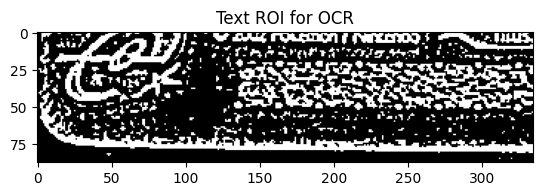

OCR result: 


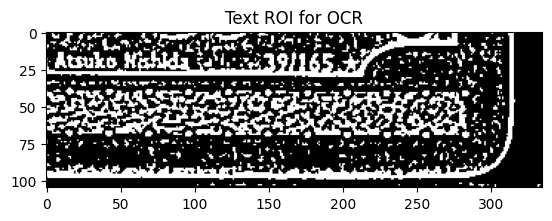

OCR result: 2G1BS
MssWs39/165YSS



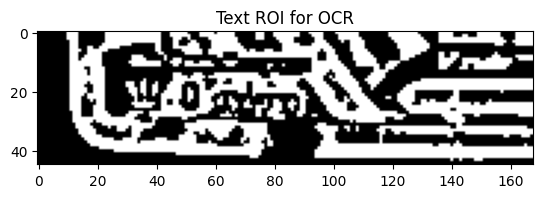

OCR result: 


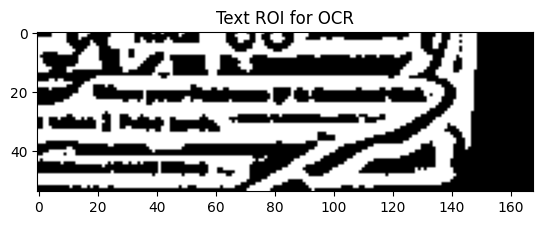

OCR result: 


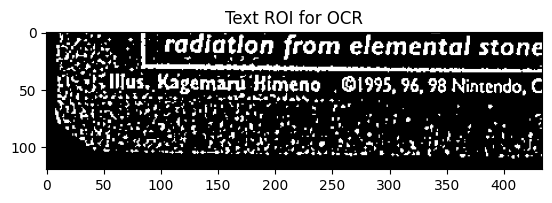

OCR result: Gss
MsMHG19959698



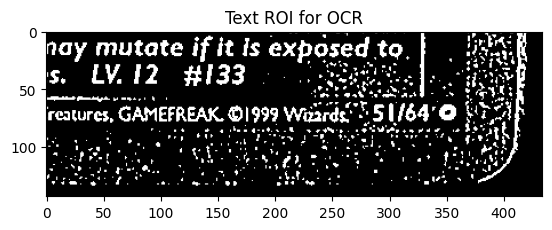

OCR result: Mss25
sM2HBB2S
sGMP01999Wss51/64



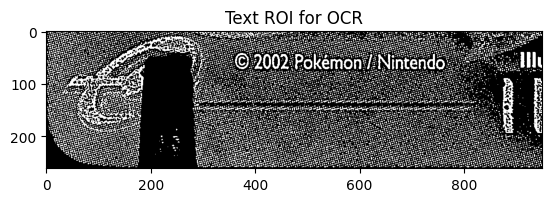

OCR result: PS
G BS 0 P Ss Bs



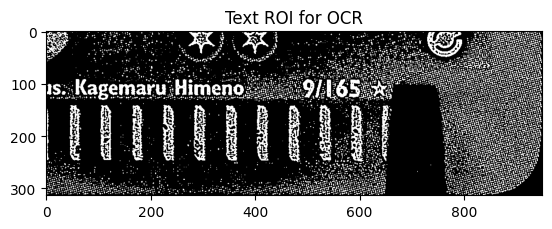

OCR result: 1sH96S



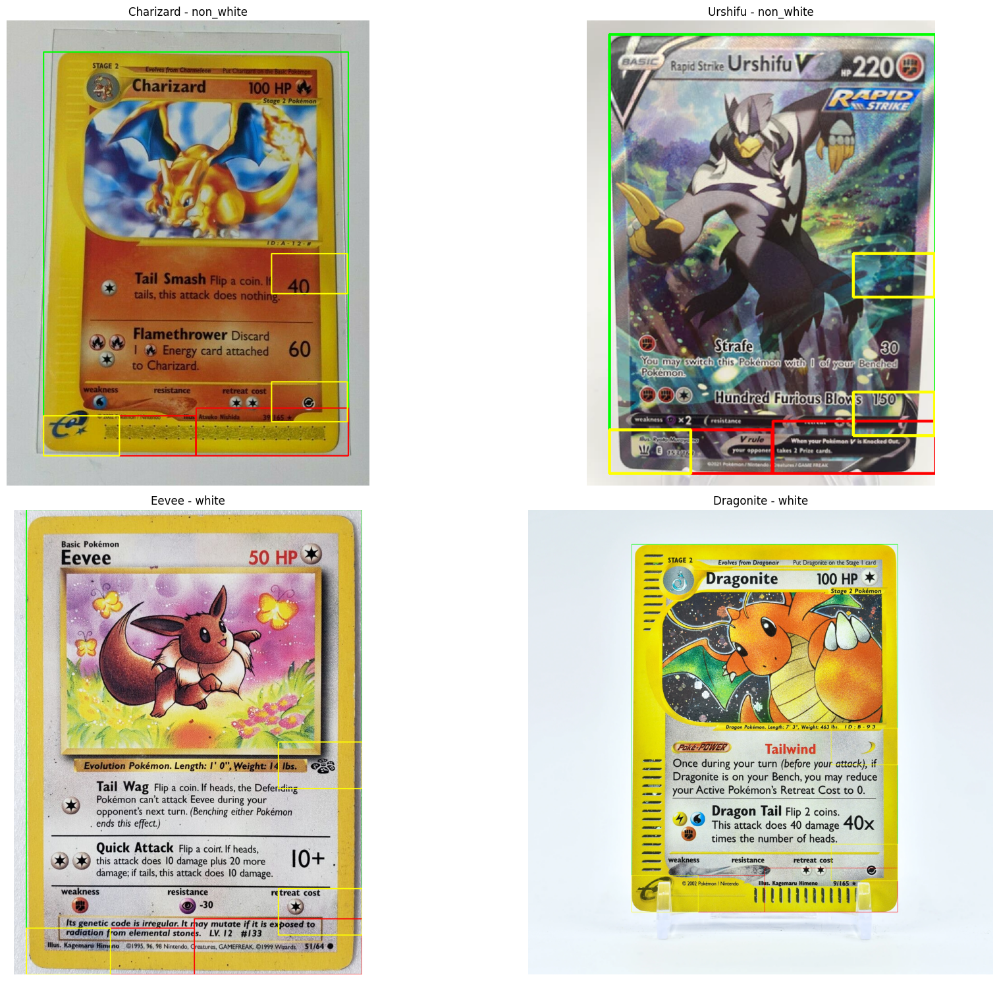

In [19]:
# Function to classify a card as white or non-white
def classify_card(image_rgb):
    """
    Classify a card as white or non-white based on its brightness level.
    """
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    mean_brightness = np.mean(gray)
    
    # Consider a card white if the mean brightness is greater than 200
    if mean_brightness > 150:
        return "white"
    else:
        return "non_white"

def adjust_brightness_contrast(image, alpha=2, beta=25):
    """
    Adjust the brightness and contrast of the image.
    Alpha: Contrast control (1.0-3.0)
    Beta: Brightness control (0-100)
    """
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

def perform_refined_ocr_on_roi(image_roi):
    # Convert the ROI to grayscale
    roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
    
    # Adjust brightness and contrast to enhance text visibility
    roi_contrast = adjust_brightness_contrast(roi_gray, alpha=1.5, beta=30)
    
    # Apply Gaussian blur to reduce noise
    roi_blur = cv2.GaussianBlur(roi_contrast, (3, 3), 0)
    
    # Apply adaptive thresholding to better detect text in varying light
    roi_thresh = cv2.adaptiveThreshold(roi_blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY_INV, 11, 2)
    
    # Optionally, apply a sharpening filter
    kernel_sharpen = np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]])
    roi_sharpen = cv2.filter2D(roi_thresh, -1, kernel_sharpen)

    # Display the ROI being passed to Tesseract
    plt.figure()
    plt.imshow(roi_sharpen, cmap='gray')
    plt.title("Text ROI for OCR")
    plt.show()

    # Convert ROI to a PIL image for OCR
    roi_pil = Image.fromarray(roi_sharpen)

    # Perform OCR
    custom_config = r'--psm 6 -c tessedit_char_whitelist=0123456789/SMWHXYDPBGs '
    text_roi = pytesseract.image_to_string(roi_pil, config=custom_config)

    # Debug: Print the OCR result for the ROI
    print(f"OCR result: {text_roi}")

    return text_roi




# # Function to perform OCR on ROIs
# def perform_ocr_on_roi(image_roi):
#     # Convert the ROI to grayscale and apply threshold
#     roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
#     _, roi_bw = cv2.threshold(roi_gray, 80, 255, cv2.THRESH_BINARY_INV)

#     # Convert ROI to a PIL image for OCR
#     roi_pil = Image.fromarray(roi_bw)

#     # Perform OCR on the ROI
#     custom_config = r'--psm 11 -c tessedit_char_whitelist=0123456789/'
#     text_roi = pytesseract.image_to_string(roi_pil, config=custom_config)

#     # Define regex patterns for matching desired text
#     pattern1 = r'\b\d{1,3}/\d{1,3}\b'  # Matches format like 0/123
#     pattern2 = r'\b[a-zA-Z]{2,4}\s*\d{1,3}\b'  # Matches format like XX123

#     # Search for matches in text_roi
#     matches = re.findall(pattern1, text_roi) + re.findall(pattern2, text_roi)

#     return matches

# Updated function to apply the white card bounding method with ROIs
def draw_bounding_box_full_card_with_rois(image_bgr):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

    # Apply a threshold for white backgrounds
    _, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY_INV)

    # Find contours in the thresholded image
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        # Find the largest contour for the bounding box
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height

        # Extract the first text ROI from the image
        first_text_roi = image_bgr[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Apply OCR on the first text ROI
        matches_first_text_roi = perform_refined_ocr_on_roi(first_text_roi)

        # --- Second Text ROI (bottom right, slightly taller) ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width  # Bottom right
        second_text_roi_y_start = y + h - second_text_roi_height

        # Extract the second text ROI from the image
        second_text_roi = image_bgr[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Apply OCR on the second text ROI
        matches_second_text_roi = perform_refined_ocr_on_roi(second_text_roi)

        # --- Set Symbol ROIs ---
        roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)
        roi_bottom_right_y_adjusted = y + h - 2 * text_roi_height + int(0.15 * text_roi_height)
        roi_bottom_right_coords = (x + w // 2 + w // 4, roi_bottom_right_y_adjusted, w // 4, text_roi_height)
        roi_middle_coords = (x + w // 2 + w // 4, y + h // 2, w // 4, text_roi_height)

        # Draw bounding box and ROIs
        image_with_rois = image_bgr.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Draw the first text ROI (blue)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start),
                      (x + text_roi_width, text_roi_y_start + text_roi_height),
                      (255, 0, 0), 2)  # Blue for text ROI

        # Draw the second text ROI (red)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start),
                      (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height),
                      (255, 0, 0), 2)  # Red for second text ROI

        # Draw the three set symbol ROIs (yellow)
        cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]),
                      (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]),
                      (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]),
                      (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        return image_with_rois
    else:
        print("No contours found.")
        return image_bgr



# Updated function to apply bounding boxes and ROIs for non-white cards
def draw_bounding_boxes(image_rgb, threshold_value):
    """
    Draw bounding boxes and ROIs after applying the given threshold value, and perform OCR on text ROIs.
    """
    # Convert the image to grayscale
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    _, thresholded = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Find contours
    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height

        # Extract the first text ROI from the image
        first_text_roi = image_rgb[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Apply OCR on the first text ROI
        matches_first_text_roi = perform_refined_ocr_on_roi(first_text_roi)

        # --- Second Text ROI (bottom right, slightly taller) ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width  # Bottom right
        second_text_roi_y_start = y + h - second_text_roi_height

        # Extract the second text ROI from the image
        second_text_roi = image_rgb[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Apply OCR on the second text ROI
        matches_second_text_roi = perform_refined_ocr_on_roi(second_text_roi)

        # --- Set Symbol ROIs ---
        roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)
        roi_bottom_right_y_adjusted = y + h - 2 * text_roi_height + int(0.15 * text_roi_height)
        roi_bottom_right_coords = (x + w // 2 + w // 4, roi_bottom_right_y_adjusted, w // 4, text_roi_height)
        roi_middle_coords = (x + w // 2 + w // 4, y + h // 2, w // 4, text_roi_height)

        # Draw bounding box and ROIs
        image_with_rois = image_rgb.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Draw the first text ROI (blue)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start),
                      (x + text_roi_width, text_roi_y_start + text_roi_height),
                      (255, 0, 0), 2)  # Blue for text ROI

        # Draw the second text ROI (red)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start),
                      (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height),
                      (255, 0, 0), 2)  # Red for second text ROI

        # Draw the three set symbol ROIs (yellow)
        cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]),
                      (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]),
                      (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]),
                      (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        return image_with_rois
    else:
        print("No contours found.")
        return image_rgb




# Main function to handle both white and non-white cards with ROIs
def draw_roi_boxes_with_dynamic_threshold_with_rois(image_rgb):
    """
    Detects if the card is white or non-white, applies the corresponding function for bounding, and returns the label.
    """
    card_type = classify_card(image_rgb)

    if card_type == "white":
        # Apply the updated white card method that includes ROIs
        image_with_bounding_box = draw_bounding_box_full_card_with_rois(image_rgb)
    else:
        # Use the regular thresholding function for non-white cards
        threshold_value = 160
        image_with_bounding_box = draw_bounding_boxes(image_rgb, threshold_value)

    return image_with_bounding_box, card_type


# Apply this logic to your local images and display results

# Test with the images (replace with actual image paths)
charizard_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\image-0.jpg')  # Replace with actual path
charizard_rgb = cv2.cvtColor(charizard_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

urshifu_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\IMG_1537_360x.webp')  # Replace with actual path
urshifu_rgb = cv2.cvtColor(urshifu_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

eevee_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\s-l1200.jpg')  # Replace with actual path
eevee_rgb = cv2.cvtColor(eevee_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

dragonite_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\e-reader.webp')  # Replace with actual path
dragonite_rgb = cv2.cvtColor(dragonite_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

# Apply the dynamic threshold function to all images
charizard_output, charizard_type = draw_roi_boxes_with_dynamic_threshold_with_rois(charizard_rgb)
urshifu_output, urshifu_type = draw_roi_boxes_with_dynamic_threshold_with_rois(urshifu_rgb)
eevee_output, eevee_type = draw_roi_boxes_with_dynamic_threshold_with_rois(eevee_rgb)
dragonite_output, dragonite_type = draw_roi_boxes_with_dynamic_threshold_with_rois(dragonite_rgb)

# Display the results for all cards with classification
plt.figure(figsize=(20, 15))

# Charizard
plt.subplot(2, 2, 1)
plt.imshow(charizard_output)
plt.title(f"Charizard - {charizard_type}")
plt.axis("off")

# Urshifu
plt.subplot(2, 2, 2)
plt.imshow(urshifu_output)
plt.title(f"Urshifu - {urshifu_type}")
plt.axis("off")

# Eevee
plt.subplot(2, 2, 3)
plt.imshow(eevee_output)
plt.title(f"Eevee - {eevee_type}")
plt.axis("off")

# Dragonite
plt.subplot(2, 2, 4)
plt.imshow(dragonite_output)
plt.title(f"Dragonite - {dragonite_type}")
plt.axis("off")

plt.tight_layout()
plt.show()


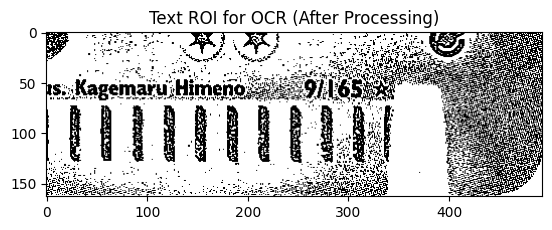

OCR result: tsi: Kagemaru:Himieno: 4 91 165e% =



'tsi: Kagemaru:Himieno: 4 91 165e% =\n'

In [66]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import pytesseract

import pytesseract

# Specify the path to the Tesseract executable
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'

# Specify the path to the tessdata folder
tessdata_dir_config = r'--tessdata-dir "C:\Program Files\Tesseract-OCR\tessdata"'


# Function to adjust brightness and contrast
def adjust_brightness_contrast(image, alpha=2.0, beta=40):
    """
    Adjust brightness and contrast of the image.
    Alpha controls contrast (1.0-3.0), Beta controls brightness (0-100).
    """
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

# Function to perform OCR with refined preprocessing
def perform_refined_ocr_on_roi(image_roi):
    # Convert the ROI to grayscale
    roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
    
    # Adjust brightness and contrast
    roi_contrast = adjust_brightness_contrast(roi_gray, alpha=1.8, beta=40)
    
    # Apply Gaussian blur to reduce noise
    roi_blur = cv2.GaussianBlur(roi_contrast, (1, 1), 0)  # Minimal blur
    
    # Apply simple binary thresholding (instead of adaptive thresholding)
    _, roi_thresh = cv2.threshold(roi_blur, 175, 255, cv2.THRESH_BINARY_INV)  # Adjust threshold value if needed
    
    # Debug: Display the processed image for OCR
    plt.imshow(roi_thresh, cmap='gray')
    plt.title("Text ROI for OCR (After Processing)")
    plt.show()

    # Convert ROI to a PIL image for OCR
    roi_pil = Image.fromarray(roi_thresh)
    
    # Perform OCR with a custom configuration
    custom_config = r'--oem 3 --psm 6 -c tessedit_do_invert=1'
    text_roi = pytesseract.image_to_string(roi_pil, config=custom_config, lang='eng')

    # Debug: Print the OCR result
    print(f"OCR result: {text_roi}")
    return text_roi

# Example usage
# Assuming `image_roi` is the region of interest (e.g., around "9/165")
image_roi = cv2.imread(r'C:\Users\Jimmy\Downloads\Capture.jpg')

# Apply OCR on the processed ROI
perform_refined_ocr_on_roi(image_roi)




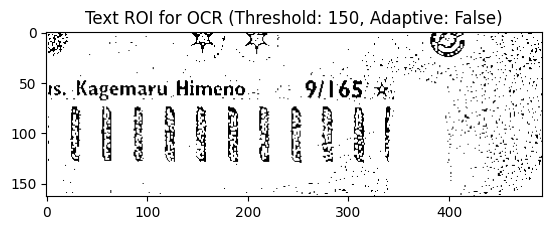

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1, Adaptive: False): oe BE ARE Ds
Is, Kagemaru Himeno - 9168 5, ~ -



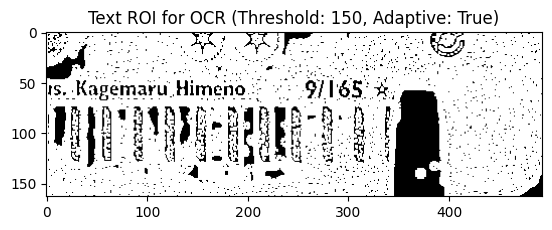

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1, Adaptive: True): Sh cccatinina 9165 he



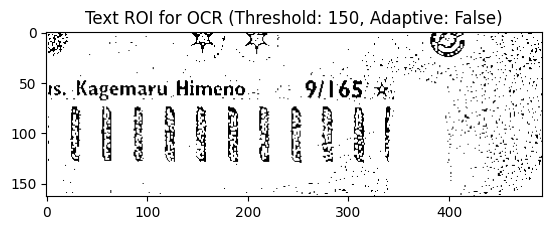

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ , Adaptive: False): 91685



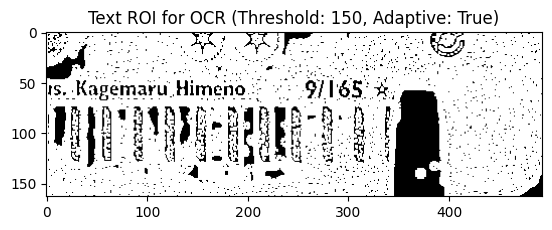

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ , Adaptive: True): 9165



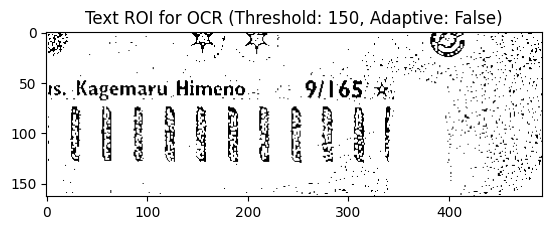

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs, Adaptive: False): 91685



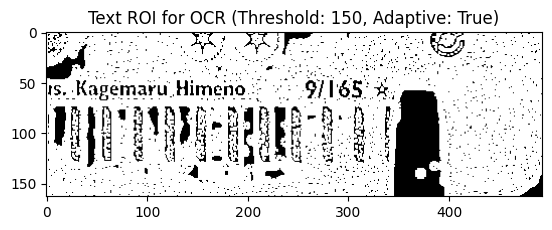

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs, Adaptive: True): 9165



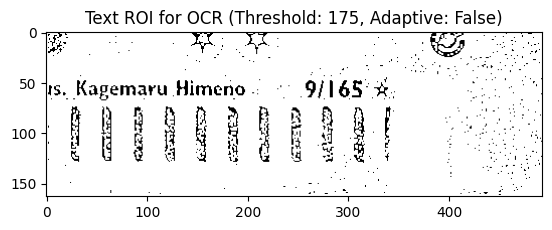

OCR result (Threshold: 175, Config: --oem 3 --psm 6 -c tessedit_do_invert=1, Adaptive: False): is. Kagemaru Himeno 91165 * oe .



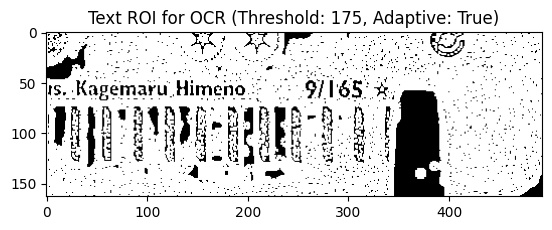

OCR result (Threshold: 175, Config: --oem 3 --psm 6 -c tessedit_do_invert=1, Adaptive: True): Sh cccatinina 9165 he



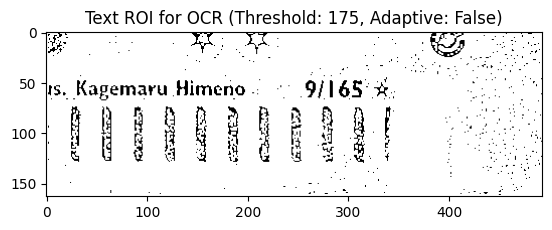

OCR result (Threshold: 175, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ , Adaptive: False): 1 91165



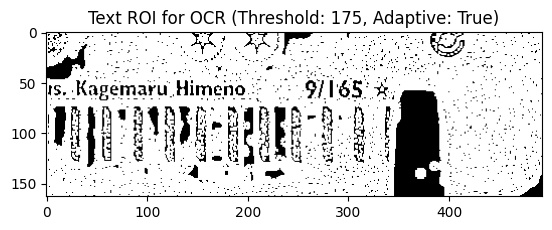

OCR result (Threshold: 175, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ , Adaptive: True): 9165



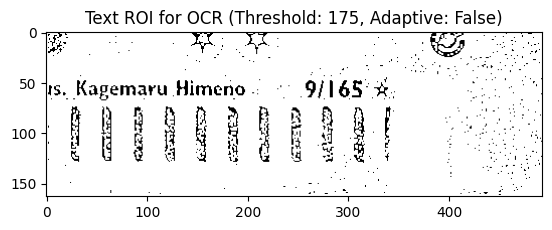

OCR result (Threshold: 175, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs, Adaptive: False): 1 91165



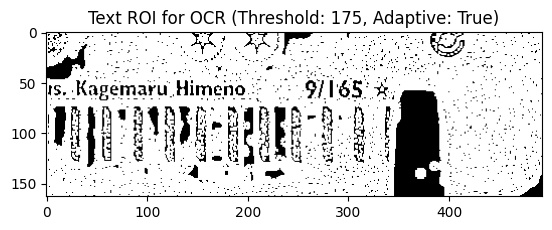

OCR result (Threshold: 175, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs, Adaptive: True): 9165



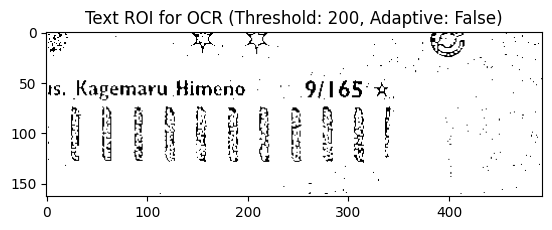

OCR result (Threshold: 200, Config: --oem 3 --psm 6 -c tessedit_do_invert=1, Adaptive: False): is, Kagemaru Himeno 9165 *
7h SR RaP EAB



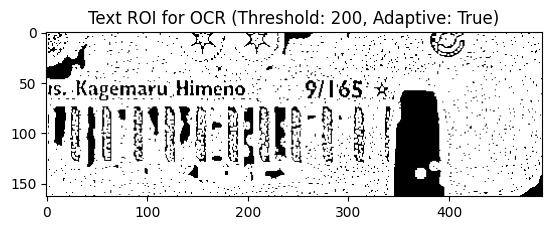

OCR result (Threshold: 200, Config: --oem 3 --psm 6 -c tessedit_do_invert=1, Adaptive: True): Sh cccatinina 9165 he



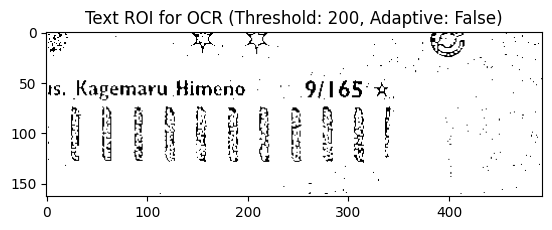

OCR result (Threshold: 200, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ , Adaptive: False): 1 9165
7



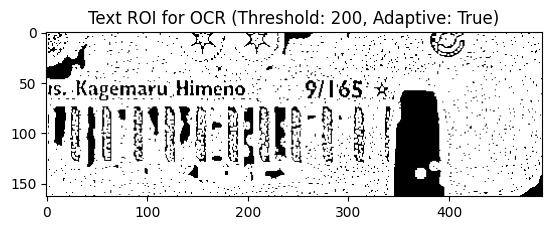

OCR result (Threshold: 200, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ , Adaptive: True): 9165



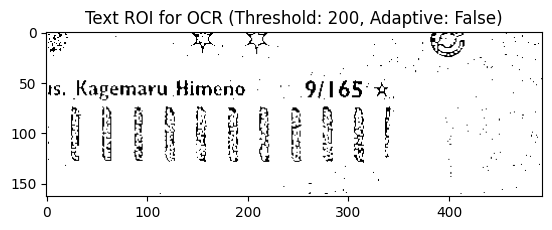

OCR result (Threshold: 200, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs, Adaptive: False): 1 9165
7



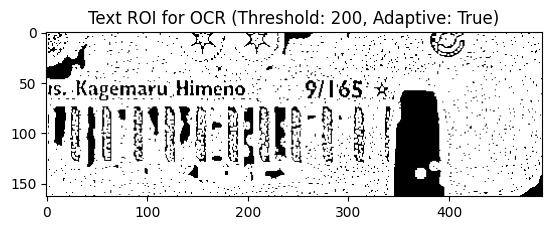

OCR result (Threshold: 200, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs, Adaptive: True): 9165

Final OCR Result: 9165



In [72]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import pytesseract
from collections import Counter

# Specify the path to the Tesseract executable
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'

# Function to adjust brightness and contrast
def adjust_brightness_contrast(image, alpha=1.6, beta=30):
    """
    Adjust brightness and contrast of the image.
    Alpha controls contrast (1.0-3.0), Beta controls brightness (0-100).
    """
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

# Function to improve feature detection
def enhance_features(image):
    """
    Apply morphological operations to make features like slashes and digits more prominent.
    Conservative dilation is used to avoid over-enhancement.
    """
    kernel = np.ones((2, 2), np.uint8)
    image_dilated = cv2.dilate(image, kernel, iterations=1)
    image_smoothed = cv2.GaussianBlur(image_dilated, (1, 1), 0)  # Smoothing after dilation
    return image_smoothed

# Function to perform OCR with refined preprocessing and varying configurations
def perform_ocr_with_configs(image_roi, threshold_value, custom_config, use_adaptive=False):
    # Convert the ROI to grayscale
    roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
    
    # Adjust brightness and contrast
    roi_contrast = adjust_brightness_contrast(roi_gray, alpha=1.6, beta=30)
    
    # Apply Gaussian blur to reduce noise
    roi_blur = cv2.GaussianBlur(roi_contrast, (1, 1), 0)  # Minimal blur
    
    if use_adaptive:
        # Apply adaptive thresholding if enabled
        roi_thresh = cv2.adaptiveThreshold(roi_blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11, 2)
    else:
        # Apply simple binary thresholding
        _, roi_thresh = cv2.threshold(roi_blur, threshold_value, 255, cv2.THRESH_BINARY_INV)
    
    # Enhance the image features using dilation and smoothing
    roi_enhanced = enhance_features(roi_thresh)

    # Debug: Display the processed image for OCR
    plt.imshow(roi_enhanced, cmap='gray')
    plt.title(f"Text ROI for OCR (Threshold: {threshold_value}, Adaptive: {use_adaptive})")
    plt.show()

    # Convert ROI to a PIL image for OCR
    roi_pil = Image.fromarray(roi_enhanced)
    
    # Perform OCR with the custom configuration
    text_roi = pytesseract.image_to_string(roi_pil, config=custom_config, lang='eng')

    return text_roi

# Function to run OCR multiple times and combine results
def run_multiple_ocr(image_roi):
    # Different threshold values to test
    threshold_values = [150, 175, 200]
    
    # Different custom configurations to test
    configs = [
        r'--oem 3 --psm 6 -c tessedit_do_invert=1',  # No whitelist
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ',  # Whitelist with numbers and "/"
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs'  # Whitelist with numbers, "/", letters
    ]
    
    # Store all OCR results
    all_results = []
    
    # Run OCR with each combination of threshold and configuration
    for threshold_value in threshold_values:
        for custom_config in configs:
            # Run OCR with both fixed and adaptive thresholding
            for use_adaptive in [False, True]:
                result = perform_ocr_with_configs(image_roi, threshold_value, custom_config, use_adaptive)
                print(f"OCR result (Threshold: {threshold_value}, Config: {custom_config}, Adaptive: {use_adaptive}): {result}")
                all_results.append(result)
    
    return all_results

# Function to combine OCR results
def combine_ocr_results(ocr_results):
    # Combine the results by picking the most frequent result from all OCR passes
    combined_result = Counter(ocr_results).most_common(1)[0][0]  # Get the most common result
    return combined_result

# Example usage
image_roi = cv2.imread(r'C:\Users\Jimmy\Downloads\Capture.jpg')

# Run multiple OCR passes with different configurations
ocr_results = run_multiple_ocr(image_roi)

# Combine the results to get the most frequent output
final_result = combine_ocr_results(ocr_results)

print(f"Final OCR Result: {final_result}")


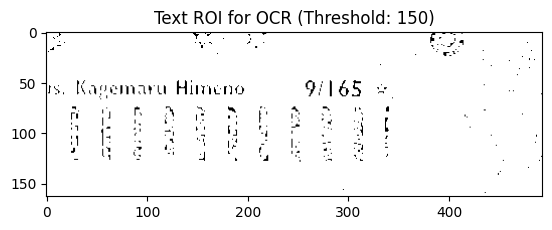

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1): is, Kagemaru Himeno 9/165.
Bion fk gy es gt



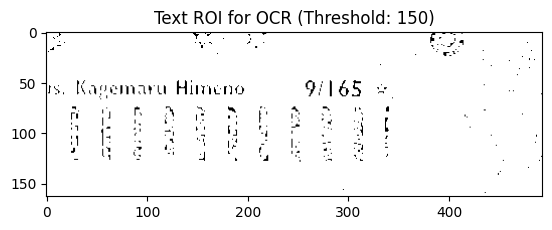

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ): 9/165



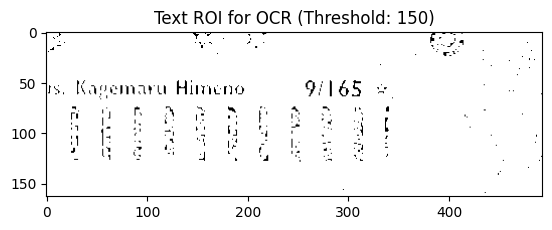

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs): 9/165

Final OCR Result: 9/165



In [75]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import pytesseract
from collections import Counter
import re

# Specify the path to the Tesseract executable
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'

# Function to adjust brightness and contrast
def adjust_brightness_contrast(image, alpha=1.6, beta=30):
    """
    Adjust brightness and contrast of the image.
    Alpha controls contrast (1.0-3.0), Beta controls brightness (0-100).
    """
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

# Function to improve feature detection
def enhance_features(image):
    """
    Apply dilation to emphasize features like slashes and digits.
    """
    kernel = np.ones((3, 3), np.uint8)
    image_dilated = cv2.dilate(image, kernel, iterations=1)
    return image_dilated

# Function to perform OCR with refined preprocessing and varying configurations
def perform_ocr_with_configs(image_roi, threshold_value, custom_config):
    # Convert the ROI to grayscale
    roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
    
    # Adjust brightness and contrast
    roi_contrast = adjust_brightness_contrast(roi_gray, alpha=1.6, beta=30)
    
    # Apply Gaussian blur to reduce noise
    roi_blur = cv2.GaussianBlur(roi_contrast, (1, 1), 0)  # Minimal blur
    
    # Apply simple binary thresholding
    _, roi_thresh = cv2.threshold(roi_blur, threshold_value, 255, cv2.THRESH_BINARY_INV)
    
    # Enhance the image features using dilation
    roi_enhanced = enhance_features(roi_thresh)

    # Debug: Display the processed image for OCR
    plt.imshow(roi_enhanced, cmap='gray')
    plt.title(f"Text ROI for OCR (Threshold: {threshold_value})")
    plt.show()

    # Convert ROI to a PIL image for OCR
    roi_pil = Image.fromarray(roi_enhanced)
    
    # Perform OCR with the custom configuration
    text_roi = pytesseract.image_to_string(roi_pil, config=custom_config, lang='eng')

    return text_roi

# Function to post-process OCR results to correct missing slash
def correct_missing_slash(ocr_text):
    # Only apply correction if the result doesn't already contain a slash
    if '/' not in ocr_text:
        # Use a regex pattern to identify the common format (e.g., 9165 or similar)
        pattern = r'(\d{1,3})(\d{2,3})'
        
        # Replace missing slash in between digit groups (e.g., 9165 -> 9/165)
        corrected_text = re.sub(pattern, r'\1/\2', ocr_text)
        
        return corrected_text
    else:
        # If a slash is already present, return the text as is
        return ocr_text

# Function to run OCR multiple times and combine results
def run_multiple_ocr(image_roi):
    # Use the fixed threshold value of 150 (since this gave good results)
    threshold_value = 150
    
    # Effective custom configurations
    configs = [
        r'--oem 3 --psm 6 -c tessedit_do_invert=1',  # No whitelist
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ',  # Whitelist with numbers and "/"
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs'  # Whitelist with numbers, "/", letters
    ]
    
    # Store all OCR results
    all_results = []
    
    # Run OCR with the threshold and different configurations
    for custom_config in configs:
        result = perform_ocr_with_configs(image_roi, threshold_value, custom_config)
        print(f"OCR result (Threshold: {threshold_value}, Config: {custom_config}): {result}")
        all_results.append(result)
    
    return all_results

# Function to combine OCR results and apply post-processing
def combine_and_correct_ocr_results(ocr_results):
    # Combine the results by picking the most frequent result from all OCR passes
    combined_result = Counter(ocr_results).most_common(1)[0][0]  # Get the most common result
    
    # Apply slash correction if necessary
    corrected_result = correct_missing_slash(combined_result)
    
    return corrected_result

# Example usage
image_roi = cv2.imread(r'C:\Users\Jimmy\Downloads\Capture.jpg')

# Run OCR passes with the effective configurations
ocr_results = run_multiple_ocr(image_roi)

# Combine the results and apply corrections for missing slashes
final_result = combine_and_correct_ocr_results(ocr_results)

print(f"Final OCR Result: {final_result}")


OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1): 
OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ): 
OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs): 
OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1): 2 ah Late Ege G12 eo Sl af
Atsuko Witida Oe 39/1 6S AY oN eS
|

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ): 212
39/16

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs): 212
39/16

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1): 
OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ): 
OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs): 
OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1):

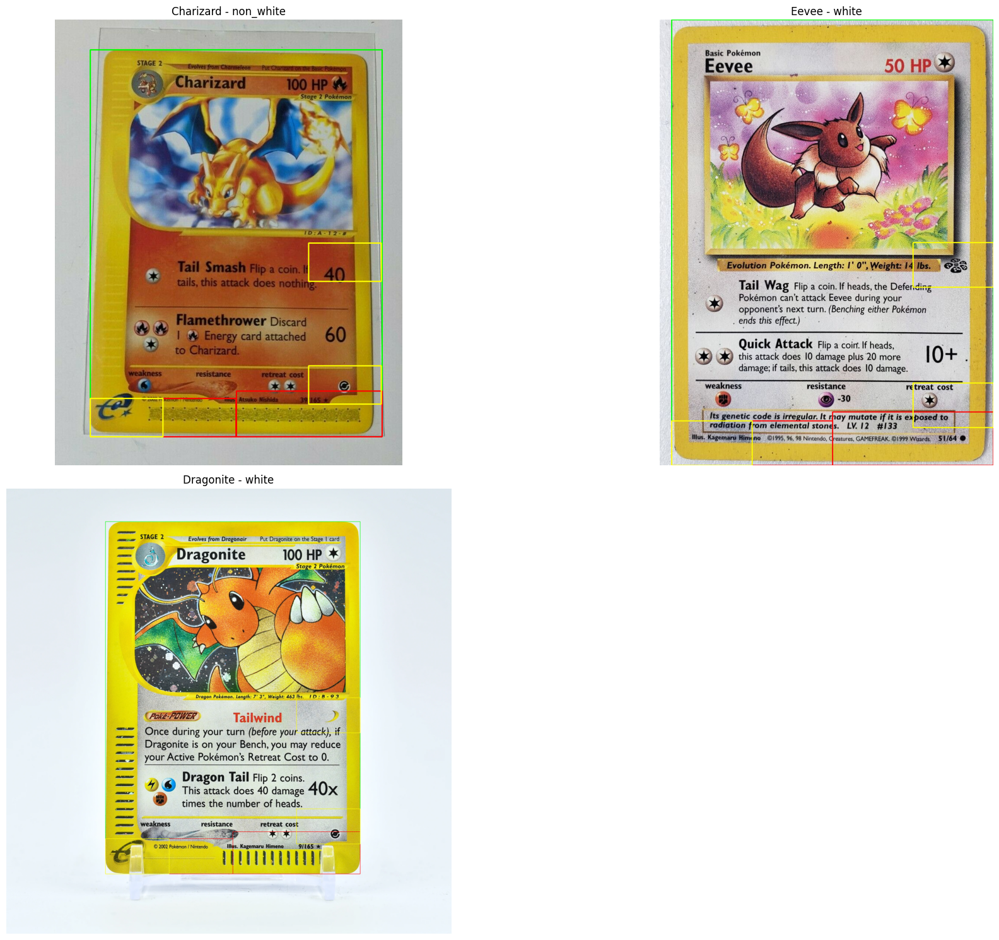

In [87]:
# Function to classify a card as white or non-white
def classify_card(image_rgb):
    """
    Classify a card as white or non-white based on its brightness level.
    """
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    mean_brightness = np.mean(gray)
    
    # Consider a card white if the mean brightness is greater than 200
    if mean_brightness > 150:
        return "white"
    else:
        return "non_white"


# Functions for processing OCR on ROI

def adjust_brightness_contrast(image, alpha=2, beta=25):
    """
    Adjust the brightness and contrast of the image.
    Alpha: Contrast control (1.0-3.0)
    Beta: Brightness control (0-100)
    """
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

# Function to improve feature detection
def enhance_features(image):
    """
    Apply dilation to emphasize features like slashes and digits.
    """
    kernel = np.ones((3, 3), np.uint8)
    image_dilated = cv2.dilate(image, kernel, iterations=1)
    return image_dilated

def ocr_preprocessing1(image_roi):
    # Convert the ROI to grayscale
    roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
    
    # Adjust brightness and contrast to enhance text visibility
    roi_contrast = adjust_brightness_contrast(roi_gray, alpha=1.5, beta=30)
    
    # Apply Gaussian blur to reduce noise
    roi_blur = cv2.GaussianBlur(roi_contrast, (3, 3), 0)
    
    # Apply adaptive thresholding to better detect text in varying light
    roi_thresh = cv2.adaptiveThreshold(roi_blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY_INV, 11, 2)
    
    # Apply a sharpening filter
    roi_sharpen = cv2.filter2D(roi_thresh, -1, np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]]))

    return roi_sharpen

# Preprocessing Technique 2 and OCR with various configurations
def perform_ocr_with_configs(image_roi, threshold_value, custom_config):
    roi_contrast = adjust_brightness_contrast(image_roi, alpha=1.6, beta=30)
    roi_blur = cv2.GaussianBlur(roi_contrast, (1, 1), 0)
    _, roi_thresh = cv2.threshold(roi_blur, threshold_value, 255, cv2.THRESH_BINARY_INV)
    roi_pil = Image.fromarray(roi_thresh)
    
    # Perform OCR with the custom configuration
    text_roi = pytesseract.image_to_string(roi_pil, config=custom_config, lang='eng')
    return text_roi

# Function to post-process OCR results: detect missing slashes or match required format
def correct_and_filter_result(ocr_text):
    # First, attempt to detect if the format is missing a slash and correct it
    if '/' not in ocr_text:
        # Regex to detect missing slash between groups of digits (e.g., 9165 -> 9/165)
        missing_slash_pattern = r'(\d{1,3})(\d{2,3})'
        corrected_text = re.sub(missing_slash_pattern, r'\1/\2', ocr_text)
    else:
        # If slash is present, no correction is needed
        corrected_text = ocr_text

    # Now match either xxxx000 or 000/000 format
    pattern = r'([a-zA-Z]{3,4}\d{3})|(\d{1,3}/\d{1,3})'
    match = re.search(pattern, corrected_text)

    # Return the corrected and filtered result if it matches, otherwise return None
    return match.group(0) if match else None


# Function to run OCR multiple times and combine results
def process_roi_with_preprocessing(image_roi):
    # Preprocess using ocr_preprocessing1
    processed_image1 = ocr_preprocessing1(image_roi)
    
    # Preprocess using perform_ocr_with_configs with multiple configurations
    threshold_value = 150
    configs = [
        r'--oem 3 --psm 6 -c tessedit_do_invert=1',
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ',
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/SMWHXYDPBGs'
    ]
    
    all_results = []
    
    for config in configs:
        ocr_result = perform_ocr_with_configs(processed_image1, threshold_value, config)
        all_results.append(ocr_result)
    
    # Combine results and apply correction/filtering
    combined_result = Counter(all_results).most_common(1)[0][0]
    final_result = correct_and_filter_result(combined_result)
    
    return final_result

# Function to combine OCR results and apply post-processing
def combine_and_correct_ocr_results(ocr_results):
    # Combine the results by picking the most frequent result from all OCR passes
    combined_result = Counter(ocr_results).most_common(1)[0][0]  # Get the most common result
    
    # Apply slash correction if necessary
    corrected_result = correct_missing_slash(combined_result)
    
    return corrected_result


# Updated function to apply the white card bounding method with ROIs
def draw_bounding_box_full_card_with_rois(image_bgr):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

    # Apply a threshold for white backgrounds
    _, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY_INV)

    # Find contours in the thresholded image
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        # Find the largest contour for the bounding box
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height

        # Extract the first text ROI from the image
        first_text_roi = image_bgr[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Preprocess and run OCR on the first text ROI
        processed_first_text_roi = ocr_preprocessing1(first_text_roi)
        ocr_results_first = run_multiple_ocr(processed_first_text_roi)
        final_result_first = combine_and_correct_ocr_results(ocr_results_first)

        # --- Second Text ROI (bottom right, slightly taller) ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width  # Bottom right
        second_text_roi_y_start = y + h - second_text_roi_height

        # Extract the second text ROI from the image
        second_text_roi = image_bgr[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Preprocess and run OCR on the second text ROI
        processed_second_text_roi = ocr_preprocessing1(second_text_roi)
        ocr_results_second = run_multiple_ocr(processed_second_text_roi)
        final_result_second = combine_and_correct_ocr_results(ocr_results_second)

        # --- Set Symbol ROIs ---
        roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)
        roi_bottom_right_y_adjusted = y + h - 2 * text_roi_height + int(0.15 * text_roi_height)
        roi_bottom_right_coords = (x + w // 2 + w // 4, roi_bottom_right_y_adjusted, w // 4, text_roi_height)
        roi_middle_coords = (x + w // 2 + w // 4, y + h // 2, w // 4, text_roi_height)

        # Draw bounding box and ROIs
        image_with_rois = image_bgr.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Draw the first text ROI (blue)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start),
                      (x + text_roi_width, text_roi_y_start + text_roi_height),
                      (255, 0, 0), 2)  # Blue for text ROI

        # Draw the second text ROI (red)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start),
                      (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height),
                      (255, 0, 0), 2)  # Red for second text ROI

        # Draw the three set symbol ROIs (yellow)
        cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]),
                      (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]),
                      (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]),
                      (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        return image_with_rois
    else:
        print("No contours found.")
        return image_bgr



# Updated function to apply bounding boxes and ROIs for non-white cards
def draw_bounding_boxes(image_rgb, threshold_value):
    """
    Draw bounding boxes and ROIs after applying the given threshold value, and perform OCR on text ROIs.
    """
    # Convert the image to grayscale
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    _, thresholded = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Find contours
    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height

        # Extract the first text ROI from the image
        first_text_roi = image_rgb[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Preprocess and apply OCR on the first text ROI
        processed_first_text_roi = ocr_preprocessing1(first_text_roi)
        ocr_results_first = run_multiple_ocr(processed_first_text_roi)
        final_result_first = combine_and_correct_ocr_results(ocr_results_first)

        # --- Second Text ROI (bottom right, slightly taller) ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width  # Bottom right
        second_text_roi_y_start = y + h - second_text_roi_height

        # Extract the second text ROI from the image
        second_text_roi = image_rgb[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Preprocess and apply OCR on the second text ROI
        processed_second_text_roi = ocr_preprocessing1(second_text_roi)
        ocr_results_second = run_multiple_ocr(processed_second_text_roi)
        final_result_second = combine_and_correct_ocr_results(ocr_results_second)

        # --- Set Symbol ROIs ---
        roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)
        roi_bottom_right_y_adjusted = y + h - 2 * text_roi_height + int(0.15 * text_roi_height)
        roi_bottom_right_coords = (x + w // 2 + w // 4, roi_bottom_right_y_adjusted, w // 4, text_roi_height)
        roi_middle_coords = (x + w // 2 + w // 4, y + h // 2, w // 4, text_roi_height)

        # Draw bounding box and ROIs
        image_with_rois = image_rgb.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Draw the first text ROI (blue)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start),
                      (x + text_roi_width, text_roi_y_start + text_roi_height),
                      (255, 0, 0), 2)  # Blue for text ROI

        # Draw the second text ROI (red)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start),
                      (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height),
                      (255, 0, 0), 2)  # Red for second text ROI

        # Draw the three set symbol ROIs (yellow)
        cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]),
                      (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]),
                      (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]),
                      (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        return image_with_rois
    else:
        print("No contours found.")
        return image_rgb




# Main function to handle both white and non-white cards with ROIs
def draw_roi_boxes_with_dynamic_threshold_with_rois(image_rgb):
    """
    Detects if the card is white or non-white, applies the corresponding function for bounding, and returns the label.
    """
    card_type = classify_card(image_rgb)

    if card_type == "white":
        # Apply the updated white card method that includes ROIs
        image_with_bounding_box = draw_bounding_box_full_card_with_rois(image_rgb)
    else:
        # Use the regular thresholding function for non-white cards
        threshold_value = 160
        image_with_bounding_box = draw_bounding_boxes(image_rgb, threshold_value)

    return image_with_bounding_box, card_type


# Apply this logic to your local images and display results

# Test with the images (replace with actual image paths)
charizard_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\image-0.jpg')  # Replace with actual path
charizard_rgb = cv2.cvtColor(charizard_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

eevee_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\s-l1200.jpg')  # Replace with actual path
eevee_rgb = cv2.cvtColor(eevee_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

dragonite_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\e-reader.webp')  # Replace with actual path
dragonite_rgb = cv2.cvtColor(dragonite_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

# Apply the dynamic threshold function to all images
charizard_output, charizard_type = draw_roi_boxes_with_dynamic_threshold_with_rois(charizard_rgb)
urshifu_output, urshifu_type = draw_roi_boxes_with_dynamic_threshold_with_rois(urshifu_rgb)
eevee_output, eevee_type = draw_roi_boxes_with_dynamic_threshold_with_rois(eevee_rgb)
dragonite_output, dragonite_type = draw_roi_boxes_with_dynamic_threshold_with_rois(dragonite_rgb)

# Display the results for all cards with classification
plt.figure(figsize=(20, 15))

# Charizard
plt.subplot(2, 2, 1)
plt.imshow(charizard_output)
plt.title(f"Charizard - {charizard_type}")
plt.axis("off")


# Eevee
plt.subplot(2, 2, 2)
plt.imshow(eevee_output)
plt.title(f"Eevee - {eevee_type}")
plt.axis("off")

# Dragonite
plt.subplot(2, 2, 3)
plt.imshow(dragonite_output)
plt.title(f"Dragonite - {dragonite_type}")
plt.axis("off")

plt.tight_layout()
plt.show()

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1): so we

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ): 
OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs): 
OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1): Bravo Ninniga 3816S &

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ): 3816

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs): 3816

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1): radiauen from elemental stone
Mh. Rayeoare Hinene © ee ot tae

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ): 6

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs): 6

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c t

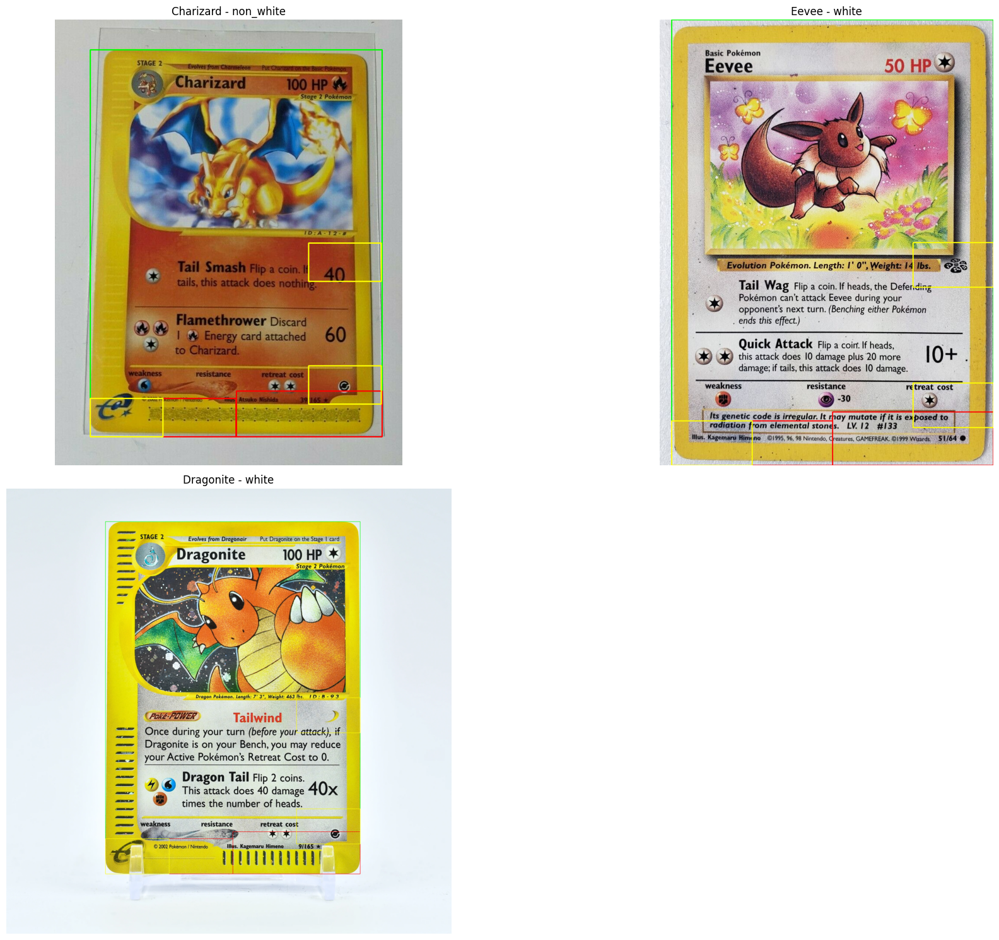

In [9]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pytesseract
from PIL import Image
from collections import Counter
import re

# Function to classify a card as white or non-white
def classify_card(image_rgb):
    """
    Classify a card as white or non-white based on its brightness level.
    """
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    mean_brightness = np.mean(gray)
    
    # Consider a card white if the mean brightness is greater than 200
    if mean_brightness > 150:
        return "white"
    else:
        return "non_white"


# Functions for processing OCR on ROI

def adjust_brightness_contrast(image, alpha=2, beta=25):
    """
    Adjust the brightness and contrast of the image.
    Alpha: Contrast control (1.0-3.0)
    Beta: Brightness control (0-100)
    """
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

# Function to improve feature detection
def enhance_features(image):
    """
    Apply dilation to emphasize features like slashes and digits.
    """
    kernel = np.ones((3, 3), np.uint8)
    image_dilated = cv2.dilate(image, kernel, iterations=1)
    return image_dilated

def ocr_preprocessing1(image_roi):
    # Step 1: Convert non-black colors to white
    # Convert the ROI to grayscale
    roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
    
    # Apply a binary inverse threshold: everything that is not black becomes white
    _, roi_thresh_black = cv2.threshold(roi_gray, 20, 255, cv2.THRESH_BINARY)

    # Step 2: Continue with regular preprocessing
    # Adjust brightness and contrast to enhance text visibility
    roi_contrast = adjust_brightness_contrast(roi_thresh_black, alpha=1.5, beta=30)
    
    # Apply Gaussian blur to reduce noise
    roi_blur = cv2.GaussianBlur(roi_contrast, (3, 3), 0)
    
    # Apply adaptive thresholding to better detect text in varying light
    roi_thresh = cv2.adaptiveThreshold(roi_blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY_INV, 11, 2)
    
    # Apply a sharpening filter to enhance edges
    roi_sharpen = cv2.filter2D(roi_thresh, -1, np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]]))

    return roi_sharpen

# Preprocessing Technique 2 and OCR with various configurations
def perform_ocr_with_configs(image_roi, threshold_value, custom_config):
    roi_contrast = adjust_brightness_contrast(image_roi, alpha=1.6, beta=30)
    roi_blur = cv2.GaussianBlur(roi_contrast, (1, 1), 0)
    _, roi_thresh = cv2.threshold(roi_blur, threshold_value, 255, cv2.THRESH_BINARY_INV)
    roi_pil = Image.fromarray(roi_thresh)
    
    # Perform OCR with the custom configuration
    text_roi = pytesseract.image_to_string(roi_pil, config=custom_config, lang='eng')
    return text_roi

# Function to post-process OCR results: detect missing slashes or match required format
def correct_and_filter_result(ocr_text):
    # First, attempt to detect if the format is missing a slash and correct it
    if '/' not in ocr_text:
        # Regex to detect missing slash between groups of digits (e.g., 9165 -> 9/165)
        missing_slash_pattern = r'(\d{1,3})(\d{2,3})'
        corrected_text = re.sub(missing_slash_pattern, r'\1/\2', ocr_text)
    else:
        # If slash is present, no correction is needed
        corrected_text = ocr_text

    # Now match either xxxx000 or 000/000 format
    pattern = r'([a-zA-Z]{3,4}\d{3})|(\d{1,3}/\d{1,3})'
    match = re.search(pattern, corrected_text)

    # Return the corrected and filtered result if it matches, otherwise return None
    return match.group(0) if match else None


# Function to run OCR multiple times and combine results
def process_roi_with_preprocessing(image_roi):
    # Preprocess using ocr_preprocessing1
    processed_image1 = ocr_preprocessing1(image_roi)
    
    # Preprocess using perform_ocr_with_configs with multiple configurations
    threshold_value = 150
    configs = [
        r'--oem 3 --psm 6 -c tessedit_do_invert=1',
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ',
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/SMWHXYDPBGs'
    ]
    
    all_results = []
    
    for config in configs:
        ocr_result = perform_ocr_with_configs(processed_image1, threshold_value, config)
        all_results.append(ocr_result)
    
    # Combine results and apply correction/filtering
    combined_result = Counter(all_results).most_common(1)[0][0]
    final_result = correct_and_filter_result(combined_result)
    
    return final_result

# Function to combine OCR results and apply post-processing
def combine_and_correct_ocr_results(ocr_results):
    # Combine the results by picking the most frequent result from all OCR passes
    combined_result = Counter(ocr_results).most_common(1)[0][0]  # Get the most common result
    
    # Apply slash correction if necessary
    corrected_result = correct_missing_slash(combined_result)
    
    return corrected_result

# Function to post-process OCR results to correct missing slash
def correct_missing_slash(ocr_text):
    # Only apply correction if the result doesn't already contain a slash
    if '/' not in ocr_text:
        # Use a regex pattern to identify the common format (e.g., 9165 or similar)
        pattern = r'(\d{1,3})(\d{2,3})'
        
        # Replace missing slash in between digit groups (e.g., 9165 -> 9/165)
        corrected_text = re.sub(pattern, r'\1/\2', ocr_text)
        
        return corrected_text
    else:
        # If a slash is already present, return the text as is
        return ocr_text


# Updated function to apply the white card bounding method with ROIs
def draw_bounding_box_full_card_with_rois(image_bgr):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

    # Apply a threshold for white backgrounds
    _, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY_INV)

    # Find contours in the thresholded image
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        # Find the largest contour for the bounding box
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height

        # Extract the first text ROI from the image
        first_text_roi = image_bgr[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Preprocess and run OCR on the first text ROI
        processed_first_text_roi = ocr_preprocessing1(first_text_roi)
        ocr_results_first = run_multiple_ocr(processed_first_text_roi)
        final_result_first = combine_and_correct_ocr_results(ocr_results_first)

        # --- Second Text ROI (bottom right, slightly taller) ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width  # Bottom right
        second_text_roi_y_start = y + h - second_text_roi_height

        # Extract the second text ROI from the image
        second_text_roi = image_bgr[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Preprocess and run OCR on the second text ROI
        processed_second_text_roi = ocr_preprocessing1(second_text_roi)
        ocr_results_second = run_multiple_ocr(processed_second_text_roi)
        final_result_second = combine_and_correct_ocr_results(ocr_results_second)

        # --- Set Symbol ROIs ---
        roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)
        roi_bottom_right_y_adjusted = y + h - 2 * text_roi_height + int(0.15 * text_roi_height)
        roi_bottom_right_coords = (x + w // 2 + w // 4, roi_bottom_right_y_adjusted, w // 4, text_roi_height)
        roi_middle_coords = (x + w // 2 + w // 4, y + h // 2, w // 4, text_roi_height)

        # Draw bounding box and ROIs
        image_with_rois = image_bgr.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Draw the first text ROI (blue)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start),
                      (x + text_roi_width, text_roi_y_start + text_roi_height),
                      (255, 0, 0), 2)  # Blue for text ROI

        # Draw the second text ROI (red)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start),
                      (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height),
                      (255, 0, 0), 2)  # Red for second text ROI

        # Draw the three set symbol ROIs (yellow)
        cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]),
                      (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]),
                      (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]),
                      (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        return image_with_rois
    else:
        print("No contours found.")
        return image_bgr



# Updated function to apply bounding boxes and ROIs for non-white cards
def draw_bounding_boxes(image_rgb, threshold_value):
    """
    Draw bounding boxes and ROIs after applying the given threshold value, and perform OCR on text ROIs.
    """
    # Convert the image to grayscale
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    _, thresholded = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Find contours
    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height

        # Extract the first text ROI from the image
        first_text_roi = image_rgb[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Preprocess and apply OCR on the first text ROI
        processed_first_text_roi = ocr_preprocessing1(first_text_roi)
        ocr_results_first = run_multiple_ocr(processed_first_text_roi)
        final_result_first = combine_and_correct_ocr_results(ocr_results_first)

        # --- Second Text ROI (bottom right, slightly taller) ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width  # Bottom right
        second_text_roi_y_start = y + h - second_text_roi_height

        # Extract the second text ROI from the image
        second_text_roi = image_rgb[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Preprocess and apply OCR on the second text ROI
        processed_second_text_roi = ocr_preprocessing1(second_text_roi)
        ocr_results_second = run_multiple_ocr(processed_second_text_roi)
        final_result_second = combine_and_correct_ocr_results(ocr_results_second)

        # --- Set Symbol ROIs ---
        roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)
        roi_bottom_right_y_adjusted = y + h - 2 * text_roi_height + int(0.15 * text_roi_height)
        roi_bottom_right_coords = (x + w // 2 + w // 4, roi_bottom_right_y_adjusted, w // 4, text_roi_height)
        roi_middle_coords = (x + w // 2 + w // 4, y + h // 2, w // 4, text_roi_height)

        # Draw bounding box and ROIs
        image_with_rois = image_rgb.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Draw the first text ROI (blue)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start),
                      (x + text_roi_width, text_roi_y_start + text_roi_height),
                      (255, 0, 0), 2)  # Blue for text ROI

        # Draw the second text ROI (red)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start),
                      (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height),
                      (255, 0, 0), 2)  # Red for second text ROI

        # Draw the three set symbol ROIs (yellow)
        cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]),
                      (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]),
                      (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]),
                      (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        return image_with_rois
    else:
        print("No contours found.")
        return image_rgb




# Main function to handle both white and non-white cards with ROIs
def draw_roi_boxes_with_dynamic_threshold_with_rois(image_rgb):
    """
    Detects if the card is white or non-white, applies the corresponding function for bounding, and returns the label.
    """
    card_type = classify_card(image_rgb)

    if card_type == "white":
        # Apply the updated white card method that includes ROIs
        image_with_bounding_box = draw_bounding_box_full_card_with_rois(image_rgb)
    else:
        # Use the regular thresholding function for non-white cards
        threshold_value = 160
        image_with_bounding_box = draw_bounding_boxes(image_rgb, threshold_value)

    return image_with_bounding_box, card_type

# Function to run OCR multiple times and combine results
def run_multiple_ocr(image_roi):
    # Use the fixed threshold value of 150 (since this gave good results)
    threshold_value = 150
    
    # Effective custom configurations
    configs = [
        r'--oem 3 --psm 6 -c tessedit_do_invert=1',  # No whitelist
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ ',  # Whitelist with numbers and "/"
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs'  # Whitelist with numbers, "/", letters
    ]
    
    # Store all OCR results
    all_results = []
    
    # Run OCR with the threshold and different configurations
    for custom_config in configs:
        result = perform_ocr_with_configs(image_roi, threshold_value, custom_config)
        print(f"OCR result (Threshold: {threshold_value}, Config: {custom_config}): {result}")
        all_results.append(result)
    
    return all_results

# Function to combine OCR results and apply post-processing
def combine_and_correct_ocr_results(ocr_results):
    # Combine the results by picking the most frequent result from all OCR passes
    combined_result = Counter(ocr_results).most_common(1)[0][0]  # Get the most common result
    
    # Apply slash correction if necessary
    corrected_result = correct_missing_slash(combined_result)
    
    return corrected_result

# Apply this logic to your local images and display results

# Test with the images (replace with actual image paths)
charizard_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\image-0.jpg')  # Replace with actual path
charizard_rgb = cv2.cvtColor(charizard_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

eevee_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\s-l1200.jpg')  # Replace with actual path
eevee_rgb = cv2.cvtColor(eevee_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

dragonite_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\e-reader.webp')  # Replace with actual path
dragonite_rgb = cv2.cvtColor(dragonite_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

# Apply the dynamic threshold function to all images
charizard_output, charizard_type = draw_roi_boxes_with_dynamic_threshold_with_rois(charizard_rgb)
eevee_output, eevee_type = draw_roi_boxes_with_dynamic_threshold_with_rois(eevee_rgb)
dragonite_output, dragonite_type = draw_roi_boxes_with_dynamic_threshold_with_rois(dragonite_rgb)

# Display the results for all cards with classification
plt.figure(figsize=(20, 15))

# Charizard
plt.subplot(2, 2, 1)
plt.imshow(charizard_output)
plt.title(f"Charizard - {charizard_type}")
plt.axis("off")


# Eevee
plt.subplot(2, 2, 2)
plt.imshow(eevee_output)
plt.title(f"Eevee - {eevee_type}")
plt.axis("off")

# Dragonite
plt.subplot(2, 2, 3)
plt.imshow(dragonite_output)
plt.title(f"Dragonite - {dragonite_type}")
plt.axis("off")

plt.tight_layout()
plt.show()

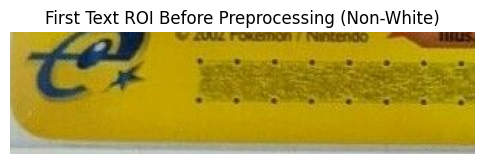

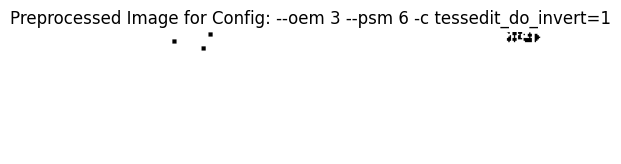

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1): so we



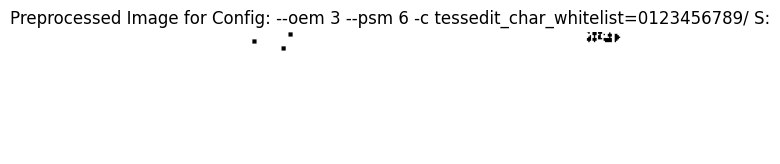

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ S:): 


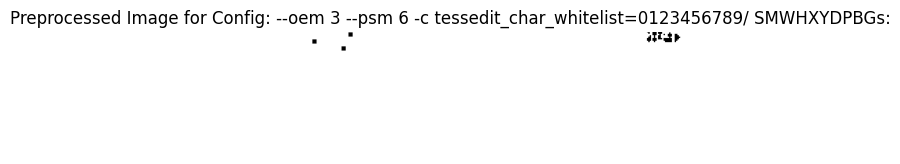

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs:): 


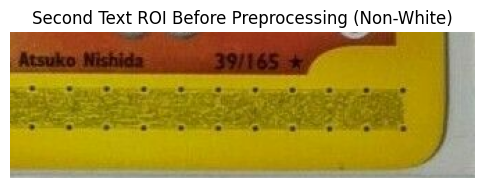

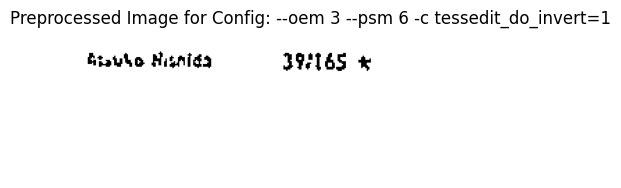

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_do_invert=1): Bravo Ninniga 3816S &



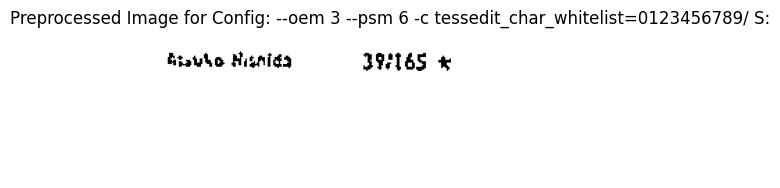

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ S:): 3816



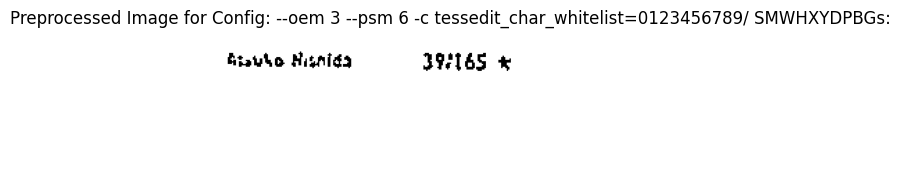

OCR result (Threshold: 150, Config: --oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs:): 3816



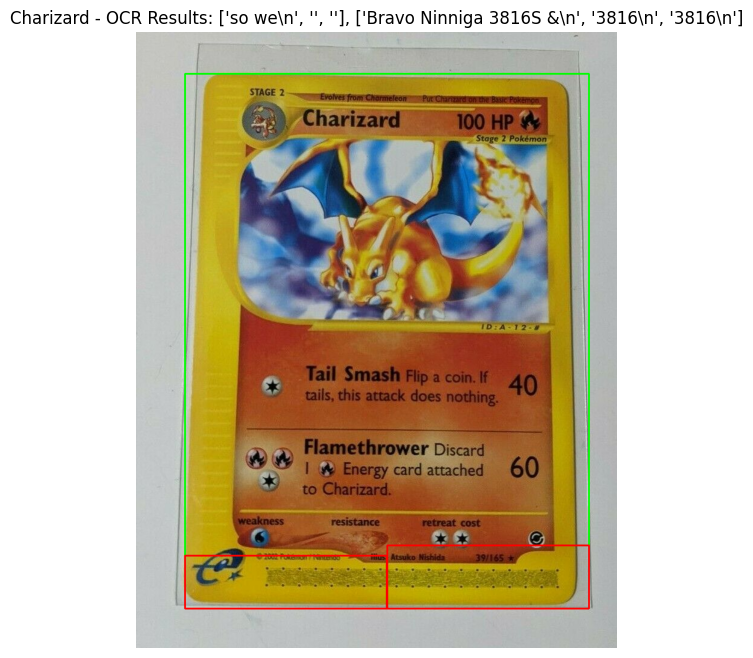

In [16]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pytesseract
from PIL import Image
from collections import Counter
import re


# Function to classify a card as white or non-white
def classify_card(image_rgb):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    mean_brightness = np.mean(gray)
    
    if mean_brightness > 150:
        return "white"
    else:
        return "non_white"


# Function to adjust brightness and contrast
def adjust_brightness_contrast(image, alpha=2, beta=25):
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)


# Function to display images for debugging
def debug_show_image(image, title="Image"):
    plt.figure(figsize=(6, 6))
    plt.imshow(image, cmap='gray')
    plt.title(title)
    plt.axis('off')
    plt.show()


# Preprocessing to identify all colors that are not black and turn them into white
def ocr_preprocessing1(image_roi):
    roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
    _, roi_thresh_black = cv2.threshold(roi_gray, 20, 255, cv2.THRESH_BINARY)
    
    roi_contrast = adjust_brightness_contrast(roi_thresh_black, alpha=1.5, beta=30)
    roi_blur = cv2.GaussianBlur(roi_contrast, (3, 3), 0)
    roi_thresh = cv2.adaptiveThreshold(roi_blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY_INV, 11, 2)
    roi_sharpen = cv2.filter2D(roi_thresh, -1, np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]]))
    
    return roi_sharpen


# Preprocessing Technique 2 and OCR with various configurations
def perform_ocr_with_configs(image_roi, threshold_value, custom_config):
    roi_contrast = adjust_brightness_contrast(image_roi, alpha=1.6, beta=30)
    roi_blur = cv2.GaussianBlur(roi_contrast, (1, 1), 0)
    _, roi_thresh = cv2.threshold(roi_blur, threshold_value, 255, cv2.THRESH_BINARY_INV)
    
    # Debugging step: show the preprocessed image before OCR
    debug_show_image(roi_thresh, title=f"Preprocessed Image for Config: {custom_config}")
    
    roi_pil = Image.fromarray(roi_thresh)
    text_roi = pytesseract.image_to_string(roi_pil, config=custom_config, lang='eng')
    
    return text_roi


# Function to run OCR multiple times and combine results
def run_multiple_ocr(image_roi):
    threshold_value = 150
    configs = [
        r'--oem 3 --psm 6 -c tessedit_do_invert=1',  
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ S:',  
        r'--oem 3 --psm 6 -c tessedit_char_whitelist=0123456789/ SMWHXYDPBGs:'  
    ]
    
    all_results = []
    
    for custom_config in configs:
        result = perform_ocr_with_configs(image_roi, threshold_value, custom_config)
        print(f"OCR result (Threshold: {threshold_value}, Config: {custom_config}): {result}")
        all_results.append(result)
    
    return all_results


# Function to extract bounding boxes and run OCR on white cards
def draw_bounding_box_full_card_with_rois(image_bgr):
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY_INV)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height
        first_text_roi = image_bgr[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Debugging: show the first ROI before preprocessing
        debug_show_image(first_text_roi, title="First Text ROI Before Preprocessing")

        processed_first_text_roi = ocr_preprocessing1(first_text_roi)
        ocr_results_first = run_multiple_ocr(processed_first_text_roi)

        # --- Second Text ROI ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width
        second_text_roi_y_start = y + h - second_text_roi_height
        second_text_roi = image_bgr[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Debugging: show the second ROI before preprocessing
        debug_show_image(second_text_roi, title="Second Text ROI Before Preprocessing")

        processed_second_text_roi = ocr_preprocessing1(second_text_roi)
        ocr_results_second = run_multiple_ocr(processed_second_text_roi)

        # Draw bounding box and ROIs
        image_with_rois = image_bgr.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start), (x + text_roi_width, text_roi_y_start + text_roi_height), (255, 0, 0), 2)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start), (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height), (255, 0, 0), 2)

        return image_with_rois, ocr_results_first, ocr_results_second

    else:
        print("No contours found.")
        return image_bgr, None, None


# Function to extract bounding boxes and run OCR on non-white cards
def draw_bounding_boxes(image_rgb, threshold_value):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    _, thresholded = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)
    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height
        first_text_roi = image_rgb[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Debugging: show the first ROI before preprocessing
        debug_show_image(first_text_roi, title="First Text ROI Before Preprocessing (Non-White)")

        processed_first_text_roi = ocr_preprocessing1(first_text_roi)
        ocr_results_first = run_multiple_ocr(processed_first_text_roi)

        # --- Second Text ROI ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width
        second_text_roi_y_start = y + h - second_text_roi_height
        second_text_roi = image_rgb[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Debugging: show the second ROI before preprocessing
        debug_show_image(second_text_roi, title="Second Text ROI Before Preprocessing (Non-White)")

        processed_second_text_roi = ocr_preprocessing1(second_text_roi)
        ocr_results_second = run_multiple_ocr(processed_second_text_roi)

        # Draw bounding box and ROIs
        image_with_rois = image_rgb.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start), (x + text_roi_width, text_roi_y_start + text_roi_height), (255, 0, 0), 2)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start), (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height), (255, 0, 0), 2)

        return image_with_rois, ocr_results_first, ocr_results_second
    else:
        print("No contours found.")
        return image_rgb, None, None


# Main function to handle both white and non-white cards
def draw_roi_boxes_with_dynamic_threshold_with_rois(image_rgb):
    card_type = classify_card(image_rgb)

    if card_type == "white":
        image_with_bounding_box, ocr_results_first, ocr_results_second = draw_bounding_box_full_card_with_rois(image_rgb)
    else:
        threshold_value = 160
        image_with_bounding_box, ocr_results_first, ocr_results_second = draw_bounding_boxes(image_rgb, threshold_value)

    return image_with_bounding_box, ocr_results_first, ocr_results_second


# Test with an example image (replace with actual image paths)
charizard_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\image-0.jpg')
charizard_rgb = cv2.cvtColor(charizard_rgb, cv2.COLOR_BGR2RGB)

# Run the debugging function
charizard_output, ocr_results_first, ocr_results_second = draw_roi_boxes_with_dynamic_threshold_with_rois(charizard_rgb)

# Display the final image with bounding boxes
plt.figure(figsize=(8, 8))
plt.imshow(charizard_output)
plt.title(f"Charizard - OCR Results: {ocr_results_first}, {ocr_results_second}")
plt.axis("off")
plt.show()


Neither CUDA nor MPS are available - defaulting to CPU. Note: This module is much faster with a GPU.


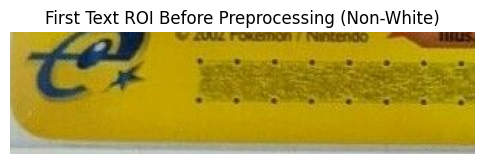

OCR result: []


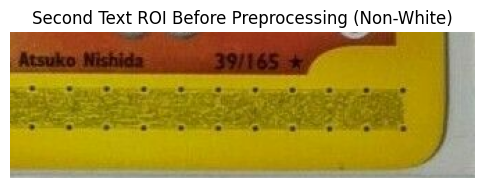

OCR result: ['tpovlo Hianidn', '39*165 +']


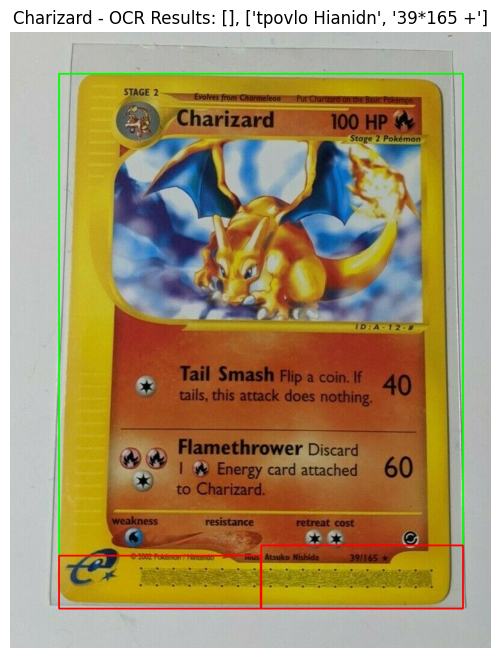

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import easyocr
from PIL import Image
from collections import Counter
import re


# Initialize EasyOCR reader (use 'en' for English)
reader = easyocr.Reader(['en'])

# Function to classify a card as white or non-white
def classify_card(image_rgb):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    mean_brightness = np.mean(gray)
    
    if mean_brightness > 150:
        return "white"
    else:
        return "non_white"


# Function to adjust brightness and contrast
def adjust_brightness_contrast(image, alpha=2, beta=25):
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)


# Function to display images for debugging
def debug_show_image(image, title="Image"):
    plt.figure(figsize=(6, 6))
    plt.imshow(image, cmap='gray')
    plt.title(title)
    plt.axis('off')
    plt.show()


# Preprocessing to identify all colors that are not black and turn them into white
def ocr_preprocessing1(image_roi):
    roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
    _, roi_thresh_black = cv2.threshold(roi_gray, 20, 255, cv2.THRESH_BINARY)
    
    roi_contrast = adjust_brightness_contrast(roi_thresh_black, alpha=1.5, beta=30)
    roi_blur = cv2.GaussianBlur(roi_contrast, (3, 3), 0)
    roi_thresh = cv2.adaptiveThreshold(roi_blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY_INV, 11, 2)
    roi_sharpen = cv2.filter2D(roi_thresh, -1, np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]]))
    
    return roi_sharpen


# OCR processing with EasyOCR
def perform_ocr_easyocr(image_roi):
    # Perform OCR using EasyOCR
    result = reader.readtext(image_roi, detail=0)
    return result


# Function to run OCR multiple times and combine results
def run_multiple_ocr(image_roi):
    # Since EasyOCR automatically handles configurations, we only need one pass
    result = perform_ocr_easyocr(image_roi)
    print(f"OCR result: {result}")
    
    return result


# Function to extract bounding boxes and run OCR on white cards
def draw_bounding_box_full_card_with_rois(image_bgr):
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY_INV)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height
        first_text_roi = image_bgr[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Debugging: show the first ROI before preprocessing
        debug_show_image(first_text_roi, title="First Text ROI Before Preprocessing")

        processed_first_text_roi = ocr_preprocessing1(first_text_roi)
        ocr_results_first = run_multiple_ocr(processed_first_text_roi)

        # --- Second Text ROI ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width
        second_text_roi_y_start = y + h - second_text_roi_height
        second_text_roi = image_bgr[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Debugging: show the second ROI before preprocessing
        debug_show_image(second_text_roi, title="Second Text ROI Before Preprocessing")

        processed_second_text_roi = ocr_preprocessing1(second_text_roi)
        ocr_results_second = run_multiple_ocr(processed_second_text_roi)

        # Draw bounding box and ROIs
        image_with_rois = image_bgr.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start), (x + text_roi_width, text_roi_y_start + text_roi_height), (255, 0, 0), 2)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start), (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height), (255, 0, 0), 2)

        return image_with_rois, ocr_results_first, ocr_results_second

    else:
        print("No contours found.")
        return image_bgr, None, None


# Function to extract bounding boxes and run OCR on non-white cards
def draw_bounding_boxes(image_rgb, threshold_value):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    _, thresholded = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)
    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height
        first_text_roi = image_rgb[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Debugging: show the first ROI before preprocessing
        debug_show_image(first_text_roi, title="First Text ROI Before Preprocessing (Non-White)")

        processed_first_text_roi = ocr_preprocessing1(first_text_roi)
        ocr_results_first = run_multiple_ocr(processed_first_text_roi)

        # --- Second Text ROI ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width
        second_text_roi_y_start = y + h - second_text_roi_height
        second_text_roi = image_rgb[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Debugging: show the second ROI before preprocessing
        debug_show_image(second_text_roi, title="Second Text ROI Before Preprocessing (Non-White)")

        processed_second_text_roi = ocr_preprocessing1(second_text_roi)
        ocr_results_second = run_multiple_ocr(processed_second_text_roi)

        # Draw bounding box and ROIs
        image_with_rois = image_rgb.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start), (x + text_roi_width, text_roi_y_start + text_roi_height), (255, 0, 0), 2)
        cv2.rectangle(image_with_rois, (second_text_roi_x_start, second_text_roi_y_start), (second_text_roi_x_start + text_roi_width, second_text_roi_y_start + second_text_roi_height), (255, 0, 0), 2)

        return image_with_rois, ocr_results_first, ocr_results_second
    else:
        print("No contours found.")
        return image_rgb, None, None


# Main function to handle both white and non-white cards
def draw_roi_boxes_with_dynamic_threshold_with_rois(image_rgb):
    card_type = classify_card(image_rgb)

    if card_type == "white":
        image_with_bounding_box, ocr_results_first, ocr_results_second = draw_bounding_box_full_card_with_rois(image_rgb)
    else:
        threshold_value = 160
        image_with_bounding_box, ocr_results_first, ocr_results_second = draw_bounding_boxes(image_rgb, threshold_value)

    return image_with_bounding_box, ocr_results_first, ocr_results_second


# Test with an example image (replace with actual image paths)
charizard_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\image-0.jpg')
charizard_rgb = cv2.cvtColor(charizard_rgb, cv2.COLOR_BGR2RGB)

# Run the debugging function
charizard_output, ocr_results_first, ocr_results_second = draw_roi_boxes_with_dynamic_threshold_with_rois(charizard_rgb)

# Display the final image with bounding boxes
plt.figure(figsize=(8, 8))
plt.imshow(charizard_output)
plt.title(f"Charizard - OCR Results: {ocr_results_first}, {ocr_results_second}")
plt.axis("off")
plt.show()


Neither CUDA nor MPS are available - defaulting to CPU. Note: This module is much faster with a GPU.


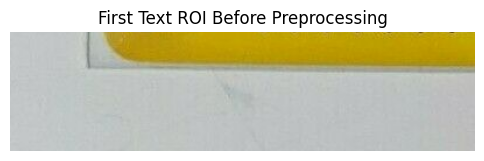

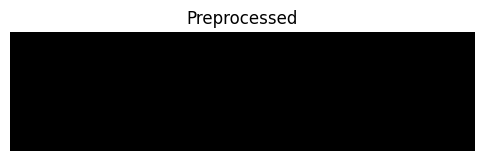

OCR result: []


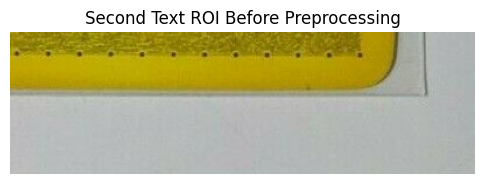

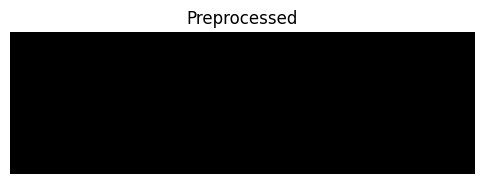

OCR result: []


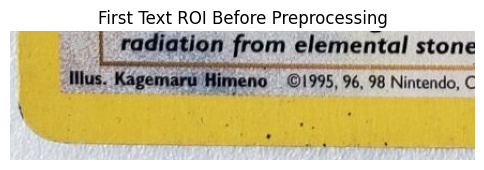

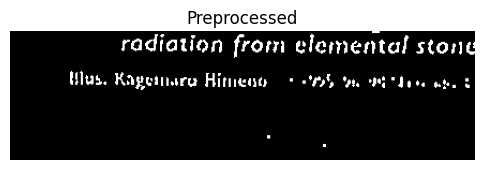

OCR result: ['radiation from elcmental stone', 'Hlus', 'Kagetllwru Hirneutr']


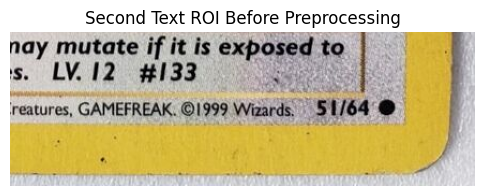

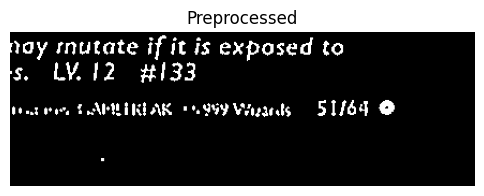

OCR result: ['ay rnutate if it is exposed to', 'LV: 12', '#133', "Mimak '95y Vxuat Is", '51/64 0']


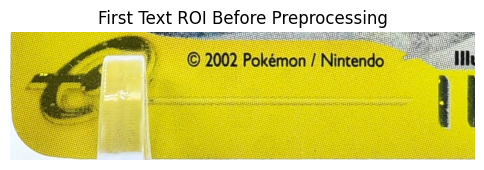

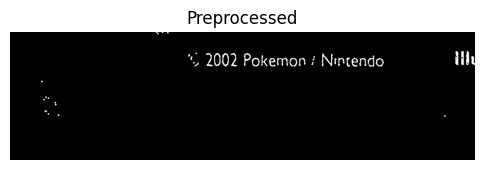

OCR result: ['2002 Pokemon', 'Ninrendo']


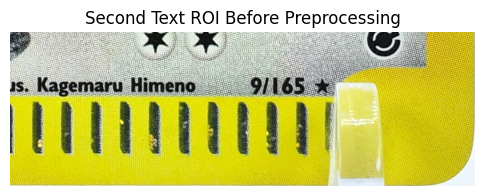

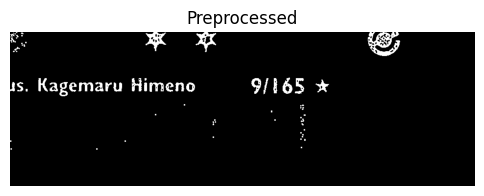

OCR result: ['JS,', 'Kagemaru Himeno', '9/165']


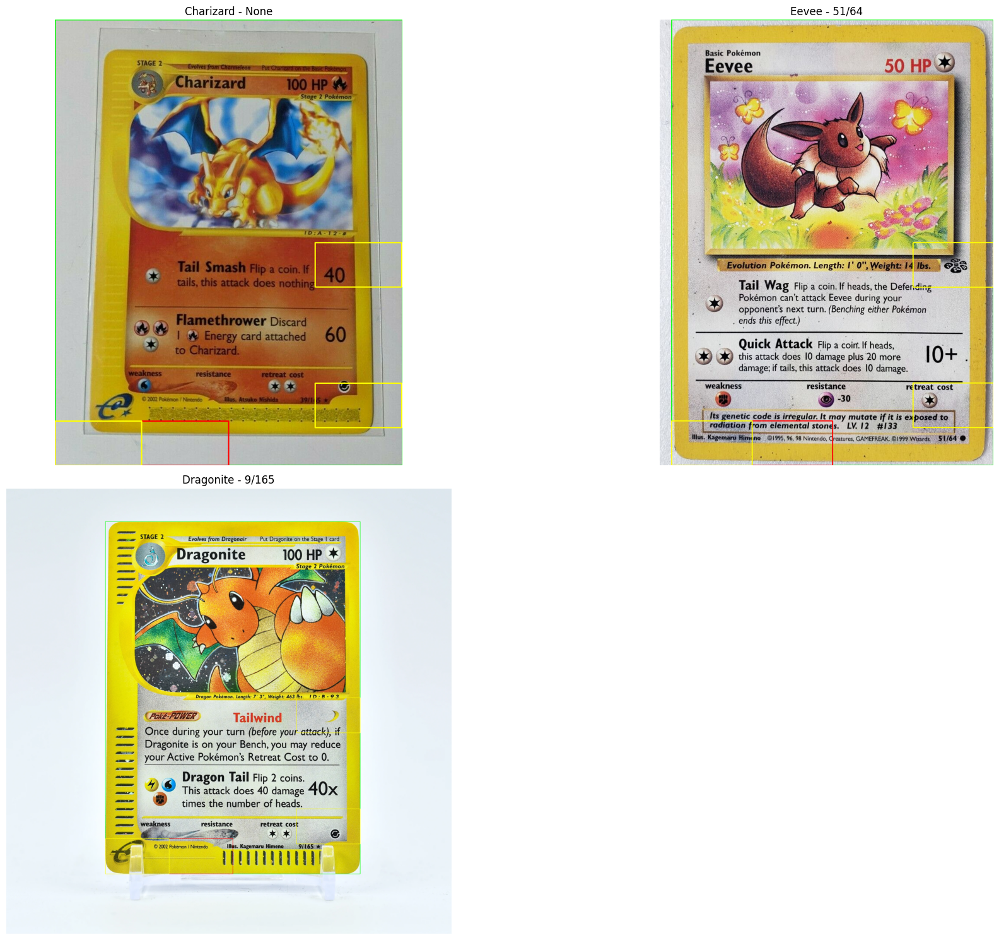

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import easyocr
from PIL import Image
import re


# Initialize EasyOCR reader (use 'en' for English)
reader = easyocr.Reader(['en'])

# Function to classify a card as white or non-white
def classify_card(image_rgb):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    mean_brightness = np.mean(gray)
    
    return "white" if mean_brightness > 150 else "non_white"


# Function to adjust brightness and contrast
def adjust_brightness_contrast(image, alpha=2, beta=25):
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)


# Function to display images for debugging
def debug_show_image(image, title="Image"):
    plt.figure(figsize=(6, 6))
    plt.imshow(image, cmap='gray')
    plt.title(title)
    plt.axis('off')
    plt.show()


# Preprocessing to identify all colors that are not black and turn them into white
def ocr_preprocessing1(image_roi):
    roi_gray = cv2.cvtColor(image_roi, cv2.COLOR_BGR2GRAY)
    _, roi_thresh_black = cv2.threshold(roi_gray, 30, 255, cv2.THRESH_BINARY)
    
    roi_contrast = adjust_brightness_contrast(roi_thresh_black, alpha=1.5, beta=30)
    roi_blur = cv2.GaussianBlur(roi_contrast, (3, 3), 0)
    roi_thresh = cv2.adaptiveThreshold(roi_blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY_INV, 11, 2)
    roi_sharpen = cv2.filter2D(roi_thresh, -1, np.array([[-1, -1, -1], [-1, 9, -1], [-1, -1, -1]]))
    
    debug_show_image(roi_sharpen, title="Preprocessed")
    return roi_sharpen


# OCR processing with EasyOCR
def perform_ocr_easyocr(image_roi):
    result = reader.readtext(image_roi, detail=0)
    print(f"OCR result: {result}")
    return result


# Function to process OCR results and select only the valid match
def process_ocr_results(ocr_results):
    # Define the patterns for the two cases
    pattern_letters_digits = r'[a-zA-Z]{2,4}\d{1,3}'  # 2-4 letters followed by 1-3 numbers
    pattern_numbers_slash = r'\d{1,3}/\d{2,3}'  # 1-3 numbers followed by / and 2-3 numbers

    for result in ocr_results:
        # Try to match both patterns
        match_letters_digits = re.search(pattern_letters_digits, result)
        match_numbers_slash = re.search(pattern_numbers_slash, result)

        # Return only the matched portion, if found
        if match_letters_digits:
            return match_letters_digits.group()  # Return the first valid match for letters-digits
        elif match_numbers_slash:
            return match_numbers_slash.group()  # Return the first valid match for numbers-slash

    return None  # Return None if no valid match is found


# Function to extract bounding boxes and run OCR on both ROIs, deciding which OCR result to keep
def draw_bounding_box_with_rois(image_bgr):
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY_INV)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w, h = cv2.boundingRect(largest_contour)

        # --- First Text ROI (for OCR) ---
        text_roi_height = h // 10
        text_roi_width = int(w * 0.5)
        text_roi_y_start = y + h - text_roi_height
        first_text_roi = image_bgr[text_roi_y_start:text_roi_y_start + text_roi_height, x:x + text_roi_width]

        # Debugging: show the first ROI before preprocessing
        debug_show_image(first_text_roi, title="First Text ROI Before Preprocessing")

        processed_first_text_roi = ocr_preprocessing1(first_text_roi)
        ocr_results_first = perform_ocr_easyocr(processed_first_text_roi)

        # --- Second Text ROI ---
        second_text_roi_height = int(text_roi_height * 1.2)
        second_text_roi_x_start = x + w - text_roi_width
        second_text_roi_y_start = y + h - second_text_roi_height
        second_text_roi = image_bgr[second_text_roi_y_start:second_text_roi_y_start + second_text_roi_height,
                                    second_text_roi_x_start:second_text_roi_x_start + text_roi_width]

        # Debugging: show the second ROI before preprocessing
        debug_show_image(second_text_roi, title="Second Text ROI Before Preprocessing")

        processed_second_text_roi = ocr_preprocessing1(second_text_roi)
        ocr_results_second = perform_ocr_easyocr(processed_second_text_roi)

        # --- Decision: Keep only one OCR result ---
        processed_ocr_result_first = process_ocr_results(ocr_results_first)
        processed_ocr_result_second = process_ocr_results(ocr_results_second)

        if processed_ocr_result_first:
            final_ocr_result = processed_ocr_result_first
        else:
            final_ocr_result = processed_ocr_result_second

        # --- Set Symbol ROIs ---
        roi_bottom_left_coords = (x, y + h - text_roi_height, w // 4, text_roi_height)
        roi_bottom_right_y_adjusted = y + h - 2 * text_roi_height + int(0.15 * text_roi_height)
        roi_bottom_right_coords = (x + w // 2 + w // 4, roi_bottom_right_y_adjusted, w // 4, text_roi_height)
        roi_middle_coords = (x + w // 2 + w // 4, y + h // 2, w // 4, text_roi_height)

        # Draw bounding box and ROIs
        image_with_rois = image_bgr.copy()
        cv2.rectangle(image_with_rois, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Draw the first text ROI (blue)
        cv2.rectangle(image_with_rois, (x, text_roi_y_start), (x + text_roi_width, text_roi_y_start + text_roi_height), (255, 0, 0), 2)

        # Draw the three set symbol ROIs (yellow)
        cv2.rectangle(image_with_rois, (roi_bottom_left_coords[0], roi_bottom_left_coords[1]),
                      (roi_bottom_left_coords[0] + roi_bottom_left_coords[2], roi_bottom_left_coords[1] + roi_bottom_left_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_bottom_right_coords[0], roi_bottom_right_coords[1]),
                      (roi_bottom_right_coords[0] + roi_bottom_right_coords[2], roi_bottom_right_coords[1] + roi_bottom_right_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        cv2.rectangle(image_with_rois, (roi_middle_coords[0], roi_middle_coords[1]),
                      (roi_middle_coords[0] + roi_middle_coords[2], roi_middle_coords[1] + roi_middle_coords[3]),
                      (255, 255, 0), 2)  # Yellow for set symbol ROI

        return image_with_rois, final_ocr_result

    else:
        print("No contours found.")
        return image_bgr, None


# Main function to handle both white and non-white cards
def draw_roi_boxes_with_dynamic_threshold(image_rgb):
    card_type = classify_card(image_rgb)
    threshold_value = 160 if card_type == "non_white" else 200
    image_with_bounding_box, ocr_result = draw_bounding_box_with_rois(image_rgb)

    return image_with_bounding_box, ocr_result


# Apply this logic to your local images and display results

# Test with the images (replace with actual image paths)
charizard_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\image-0.jpg')  # Replace with actual path
charizard_rgb = cv2.cvtColor(charizard_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

eevee_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\s-l1200.jpg')  # Replace with actual path
eevee_rgb = cv2.cvtColor(eevee_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

dragonite_rgb = cv2.imread(r'C:\Users\Jimmy\Desktop\cb-ds-19\00_Projects\ds-final-project-main\Test Image\e-reader.webp')  # Replace with actual path
dragonite_rgb = cv2.cvtColor(dragonite_rgb, cv2.COLOR_BGR2RGB)  # Ensure correct format

# Apply the dynamic threshold function to all images
charizard_output, charizard_ocr_result = draw_roi_boxes_with_dynamic_threshold(charizard_rgb)
eevee_output, eevee_ocr_result = draw_roi_boxes_with_dynamic_threshold(eevee_rgb)
dragonite_output, dragonite_ocr_result = draw_roi_boxes_with_dynamic_threshold(dragonite_rgb)


# Display the results for all cards with classification
plt.figure(figsize=(20, 15))

# Charizard
plt.subplot(2, 2, 1)
plt.imshow(charizard_output)
plt.title(f"Charizard - {charizard_ocr_result}")
plt.axis("off")

# Eevee
plt.subplot(2, 2, 2)
plt.imshow(eevee_output)
plt.title(f"Eevee - {eevee_ocr_result}")
plt.axis("off")

# Dragonite
plt.subplot(2, 2, 3)
plt.imshow(dragonite_output)
plt.title(f"Dragonite - {dragonite_ocr_result}")
plt.axis("off")

plt.tight_layout()
plt.show()
